In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'B1_2_wakkanai_alt_depth2'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  B1_2_wakkanai_alt_depth2
SEED  :  1
HOST  :  7574709303cc
START :  2019-03-17 21:40:26.314182


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.95*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

        self.enp = self.BOPT - self.batt
#         self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.btrack.mean()
        bdev = self.BOPT - bmean
        if np.abs(bdev) > (self.BOPT - self.BLIM_LO):
            reward = 2-np.abs(bdev)/self.BMAX*10
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
        self.enp = self.BOPT - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = 24*7*4*12*3   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 50            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
        self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
        x = self.fc2(x)
        x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.good_memory_counter = 0                                         # for storing memory
        self.good_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        self.bad_memory_counter = 0                                         # for storing memory
        self.bad_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-3, 3)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition):
      
        if(transition[-1][5] < 0):
            index = self.bad_memory_counter % MEMORY_CAPACITY
            self.bad_memory= np.insert(self.bad_memory, index, transition,0)
            self.bad_memory_counter += transition.shape[0]
            self.bad_memory=self.bad_memory[:int(MEMORY_CAPACITY)]
        
        else:
            index = self.good_memory_counter % MEMORY_CAPACITY
            self.good_memory= np.insert(self.good_memory, index, transition,0)
            self.good_memory_counter += transition.shape[0]
            self.good_memory=self.good_memory[:int(MEMORY_CAPACITY)]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        good_sample_index = np.random.choice(int(MEMORY_CAPACITY), int(0.5*BATCH_SIZE))
        bad_sample_index  = np.random.choice(int(MEMORY_CAPACITY), BATCH_SIZE - int(BATCH_SIZE*0.50))

        b_good_memory = self.good_memory[good_sample_index, :]
        b_bad_memory = self.bad_memory[bad_sample_index, :]
        b_memory = np.vstack((b_good_memory,b_bad_memory))

        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  9500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


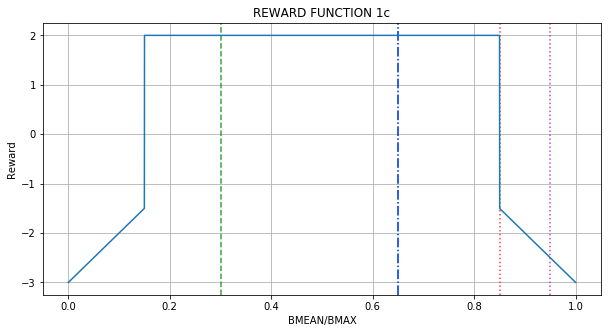

RF_1c(0)            =  -3.00
RF_1c(ENP_MARGIN/4) =  -3.00
RF_1c(ENP_MARGIN/2) =  -3.00
RF_1c(ENP_MARGIN)   =  -3.00

RF_1c(BMAX/2) =  -3.00
RF_1c(BMAX)   =  -3.00



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0,capm.BMAX)
y = [capm.rewardfn() for capm.btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.75, linestyle='--')
ax.axvline(1-(capm.BSAFE_LO)/capm.BMAX, color='c',alpha=0.75, linestyle='-.')
ax.axvline(  (capm.BSAFE_HI)/capm.BMAX, color='b',alpha=0.75, linestyle="-.")
ax.axvline(1- (capm.BLIM_LO)/capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline(   (capm.BLIM_HI)/capm.BMAX, color='m',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  WAKKANAI, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  = -1.454
Day Violations           =    229
Battery Limit Violations =    988
Action MEAN              =  2.966
Action STD DEV           =  2.012


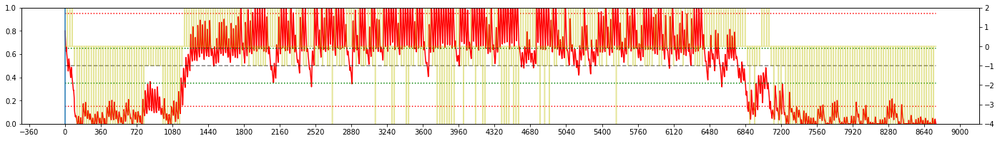


Iteration 1:  WAKKANAI, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  = -1.423
Day Violations           =    220
Battery Limit Violations =    973
Action MEAN              =  2.849
Action STD DEV           =  1.947


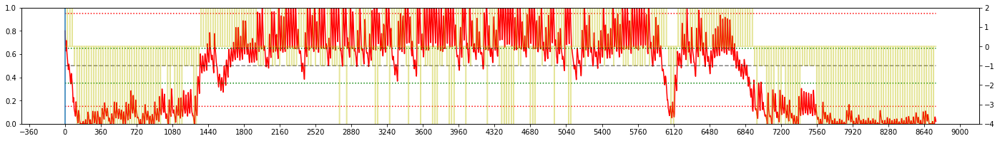


Iteration 2:  WAKKANAI, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  = -1.667
Day Violations           =    231
Battery Limit Violations =   1070
Action MEAN              =  2.740
Action STD DEV           =  1.931


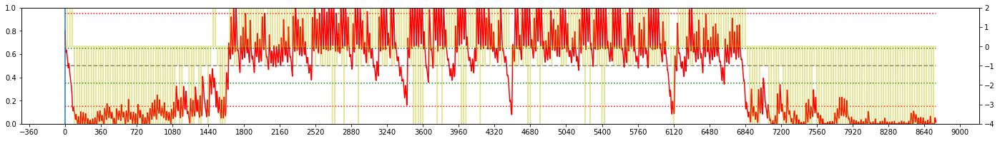


Iteration 3:  WAKKANAI, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  = -1.536
Day Violations           =    231
Battery Limit Violations =    997
Action MEAN              =  2.813
Action STD DEV           =  1.967


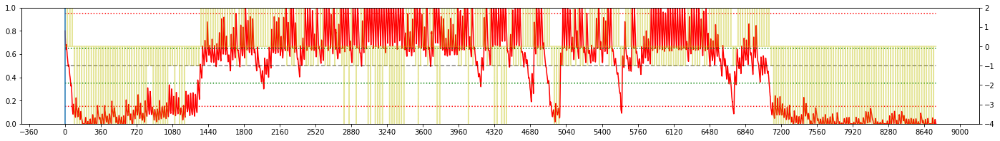


Iteration 4:  WAKKANAI, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  = -1.437
Day Violations           =    229
Battery Limit Violations =    871
Action MEAN              =  2.727
Action STD DEV           =  1.898


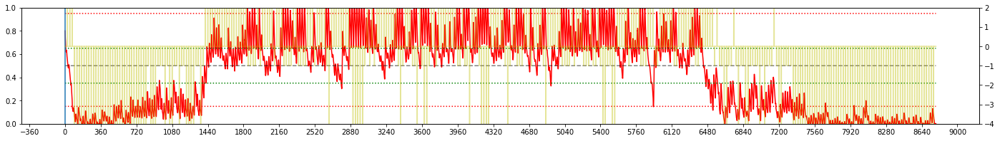


Iteration 5:  WAKKANAI, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  = -1.619
Day Violations           =    229
Battery Limit Violations =   1003
Action MEAN              =  2.838
Action STD DEV           =  1.968


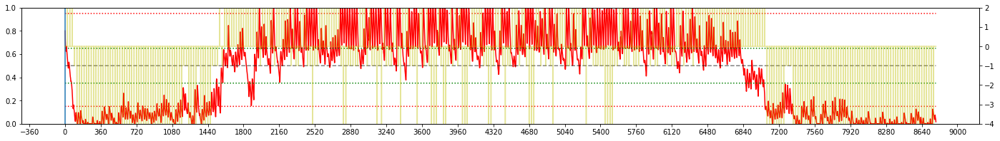


Iteration 6:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  = -1.518
Day Violations           =    232
Battery Limit Violations =    990
Action MEAN              =  2.969
Action STD DEV           =  2.027


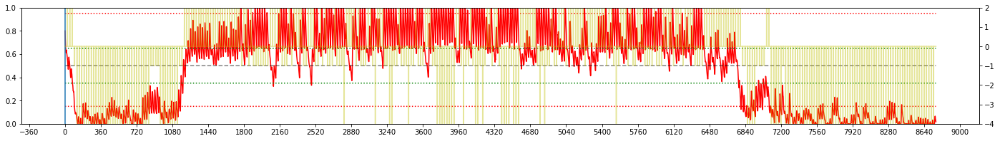


Iteration 7:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  = -2.359
Day Violations           =    244
Battery Limit Violations =   2107
Action MEAN              =  3.682
Action STD DEV           =  2.611


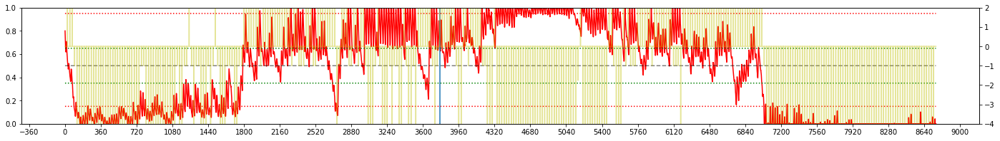


Iteration 8:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  = -1.831
Day Violations           =    242
Battery Limit Violations =   2595
Action MEAN              =  4.694
Action STD DEV           =  2.908


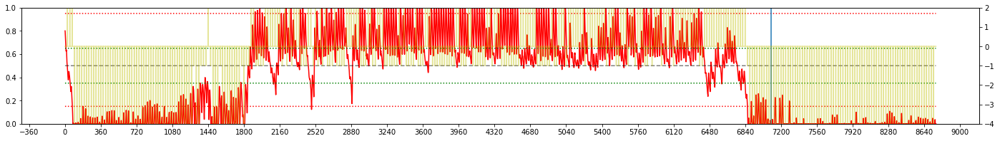


Iteration 9:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  = -1.047
Day Violations           =    184
Battery Limit Violations =   1665
Action MEAN              =  3.386
Action STD DEV           =  2.596


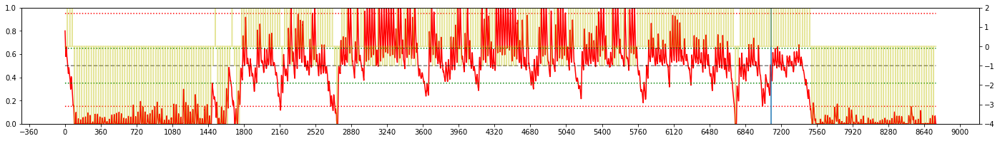


Iteration 10:  WAKKANAI, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  = -0.406
Day Violations           =    133
Battery Limit Violations =   1501
Action MEAN              =  3.652
Action STD DEV           =  2.841


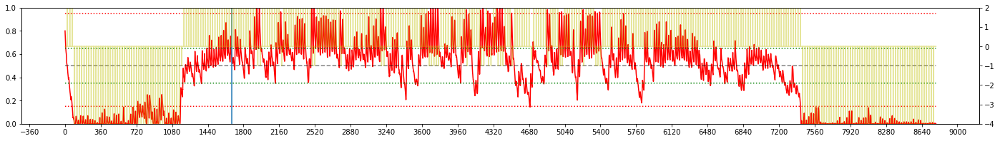


Iteration 11:  WAKKANAI, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  = -0.088
Day Violations           =    118
Battery Limit Violations =   1327
Action MEAN              =  3.791
Action STD DEV           =  2.948


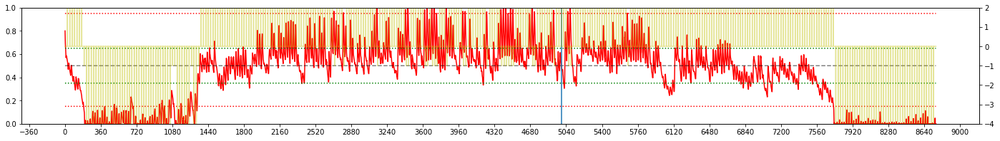


Iteration 12:  WAKKANAI, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  =  0.362
Day Violations           =     84
Battery Limit Violations =   1131
Action MEAN              =  3.334
Action STD DEV           =  2.782


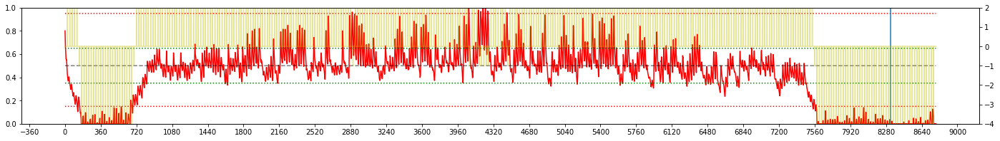


Iteration 13:  WAKKANAI, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  =  0.155
Day Violations           =    101
Battery Limit Violations =   1066
Action MEAN              =  3.262
Action STD DEV           =  2.776


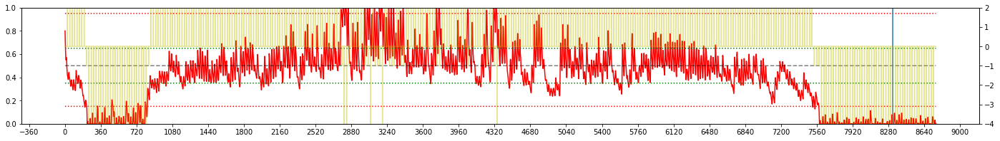


Iteration 14:  WAKKANAI, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  =  0.099
Day Violations           =     92
Battery Limit Violations =   1150
Action MEAN              =  3.299
Action STD DEV           =  2.897


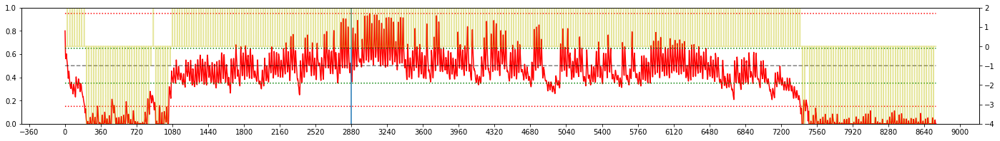


Iteration 15:  WAKKANAI, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  =  0.054
Day Violations           =     97
Battery Limit Violations =   1127
Action MEAN              =  3.364
Action STD DEV           =  2.996


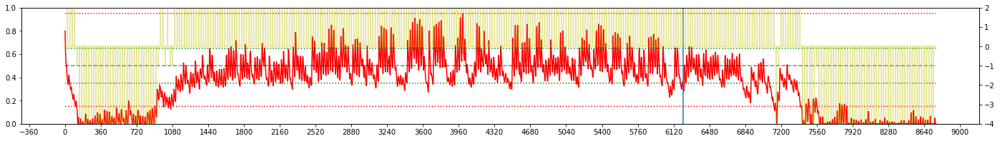


Iteration 16:  WAKKANAI, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  =  0.310
Day Violations           =     81
Battery Limit Violations =   1213
Action MEAN              =  3.733
Action STD DEV           =  3.192


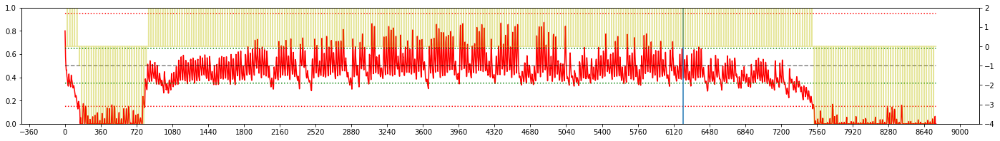


Iteration 17:  WAKKANAI, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  =  0.428
Day Violations           =     77
Battery Limit Violations =   1191
Action MEAN              =  3.428
Action STD DEV           =  3.064


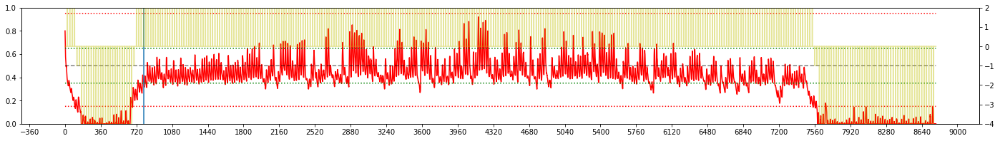


Iteration 18:  WAKKANAI, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  =  0.325
Day Violations           =     80
Battery Limit Violations =   1149
Action MEAN              =  3.613
Action STD DEV           =  3.047


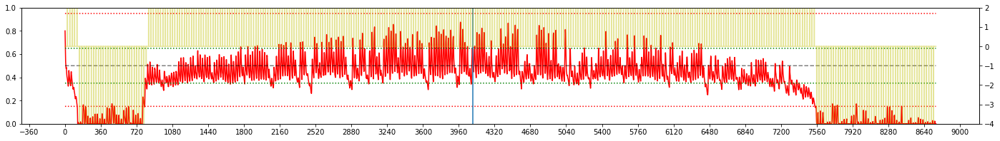


Iteration 19:  WAKKANAI, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  =  0.021
Day Violations           =     95
Battery Limit Violations =   1449
Action MEAN              =  3.480
Action STD DEV           =  3.103


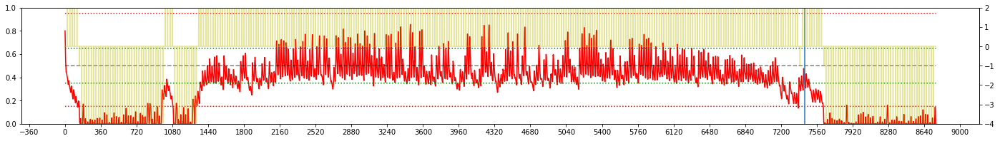


Iteration 20:  WAKKANAI, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  = -0.158
Day Violations           =    103
Battery Limit Violations =   1594
Action MEAN              =  3.845
Action STD DEV           =  3.313


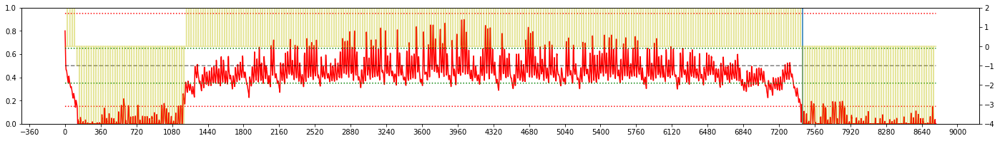


Iteration 21:  WAKKANAI, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  =  0.231
Day Violations           =     84
Battery Limit Violations =   1346
Action MEAN              =  3.760
Action STD DEV           =  3.202


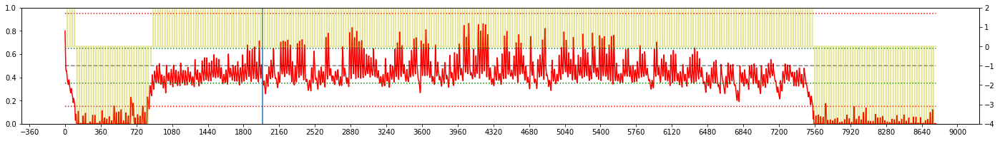


Iteration 22:  WAKKANAI, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  =  0.198
Day Violations           =     87
Battery Limit Violations =   1394
Action MEAN              =  4.234
Action STD DEV           =  3.404


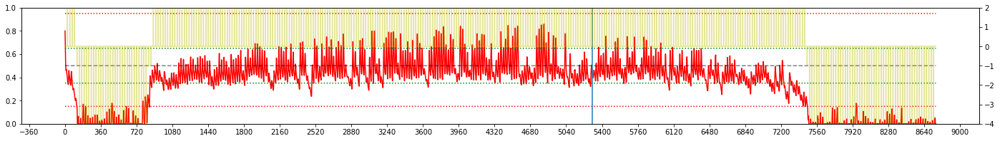


Iteration 23:  WAKKANAI, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  =  0.214
Day Violations           =     86
Battery Limit Violations =   1264
Action MEAN              =  3.888
Action STD DEV           =  3.323


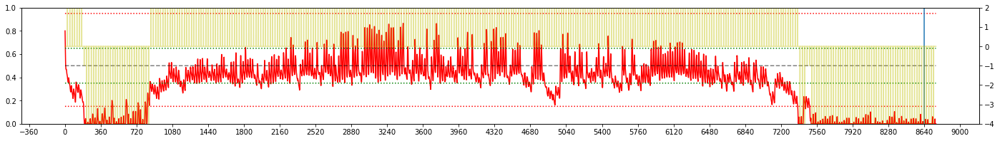


Iteration 24:  WAKKANAI, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  =  0.273
Day Violations           =     83
Battery Limit Violations =   1171
Action MEAN              =  3.579
Action STD DEV           =  2.988


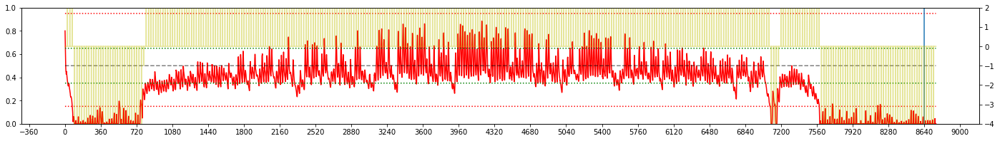


Iteration 25:  WAKKANAI, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  =  0.273
Day Violations           =     85
Battery Limit Violations =   1211
Action MEAN              =  3.567
Action STD DEV           =  2.968


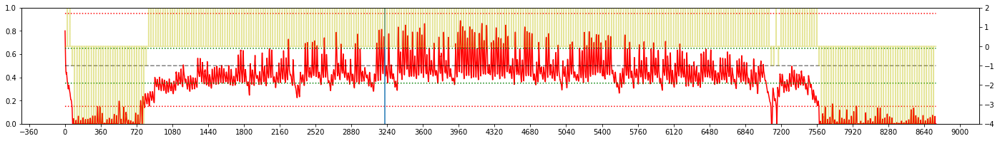


Iteration 26:  WAKKANAI, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  = -0.040
Day Violations           =     99
Battery Limit Violations =   1444
Action MEAN              =  3.974
Action STD DEV           =  3.163


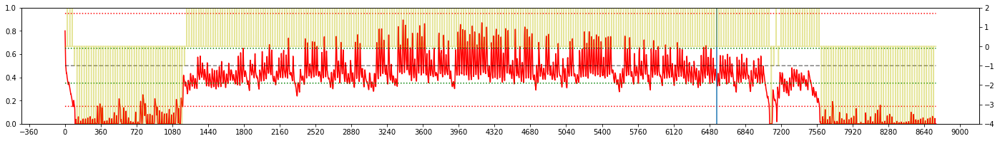


Iteration 27:  WAKKANAI, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  =  0.140
Day Violations           =     88
Battery Limit Violations =   1404
Action MEAN              =  3.845
Action STD DEV           =  2.865


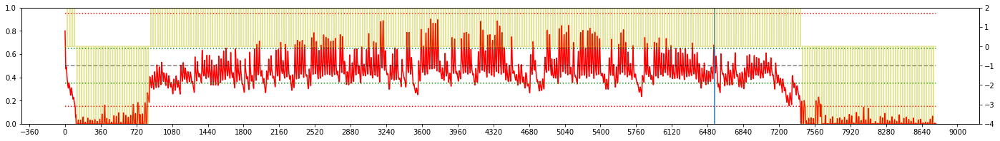


Iteration 28:  WAKKANAI, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  = -0.080
Day Violations           =    102
Battery Limit Violations =   1557
Action MEAN              =  3.894
Action STD DEV           =  2.935


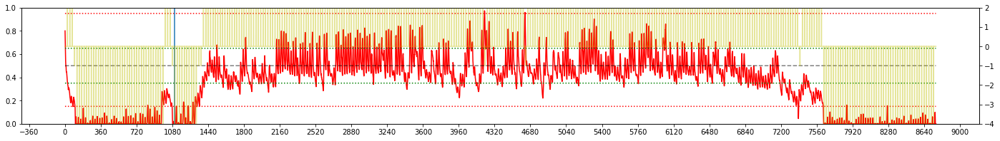


Iteration 29:  WAKKANAI, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  =  0.297
Day Violations           =     83
Battery Limit Violations =   1325
Action MEAN              =  4.263
Action STD DEV           =  3.160


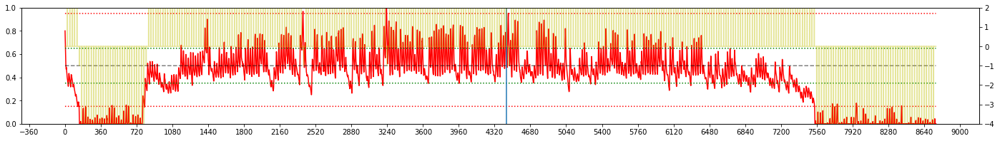


Iteration 30:  WAKKANAI, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  = -0.002
Day Violations           =     95
Battery Limit Violations =   1530
Action MEAN              =  3.947
Action STD DEV           =  2.994


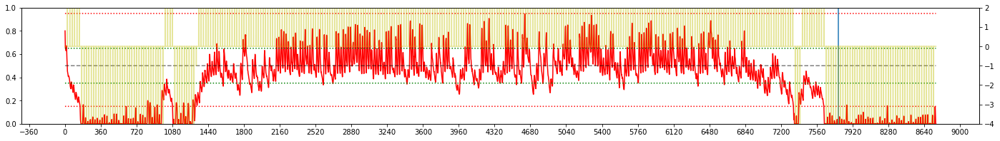


Iteration 31:  WAKKANAI, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  =  0.209
Day Violations           =     91
Battery Limit Violations =   1348
Action MEAN              =  3.975
Action STD DEV           =  3.082


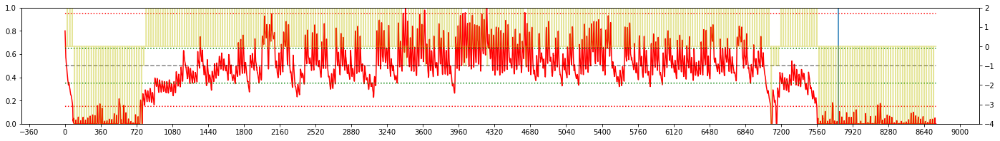


Iteration 32:  WAKKANAI, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  =  0.247
Day Violations           =     88
Battery Limit Violations =   1365
Action MEAN              =  3.748
Action STD DEV           =  2.967


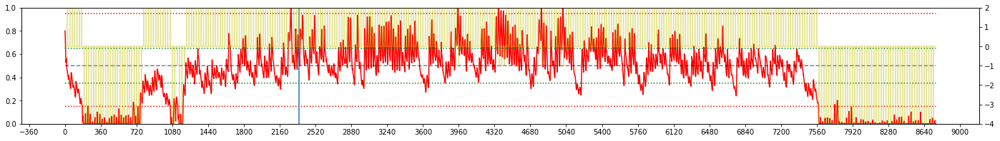


Iteration 33:  WAKKANAI, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  = -0.090
Day Violations           =    104
Battery Limit Violations =   1615
Action MEAN              =  4.096
Action STD DEV           =  3.037


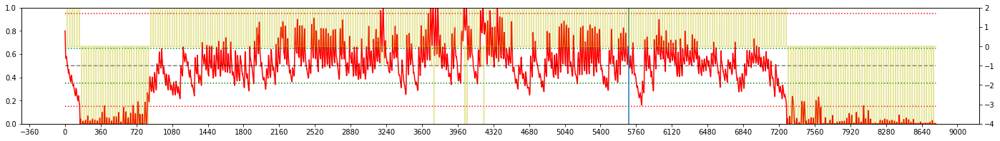


Iteration 34:  WAKKANAI, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  =  0.387
Day Violations           =     82
Battery Limit Violations =   1250
Action MEAN              =  3.855
Action STD DEV           =  3.089


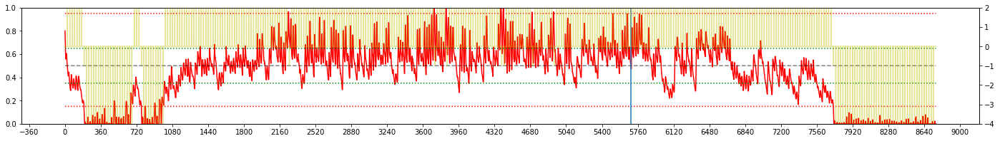


Iteration 35:  WAKKANAI, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  =  0.139
Day Violations           =     94
Battery Limit Violations =   1510
Action MEAN              =  4.281
Action STD DEV           =  3.307


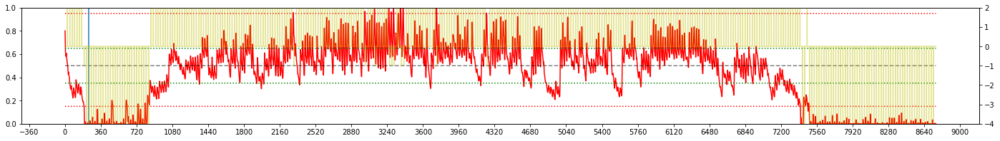


Iteration 36:  WAKKANAI, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  =  0.109
Day Violations           =     96
Battery Limit Violations =   1376
Action MEAN              =  4.036
Action STD DEV           =  3.145


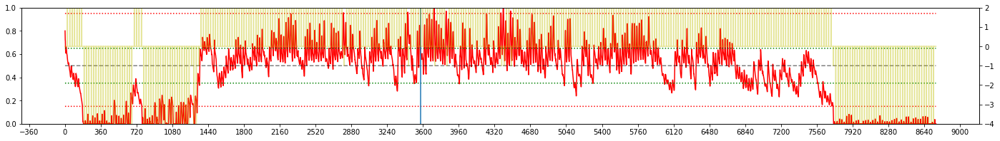


Iteration 37:  WAKKANAI, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  =  0.266
Day Violations           =     84
Battery Limit Violations =   1354
Action MEAN              =  3.592
Action STD DEV           =  2.800


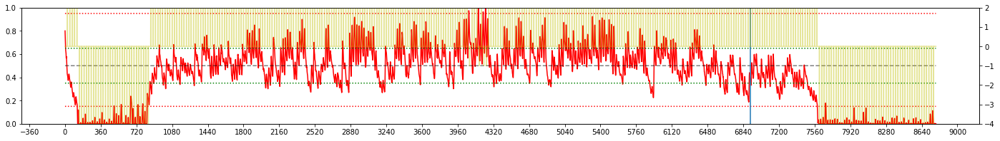


Iteration 38:  WAKKANAI, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  =  0.402
Day Violations           =     83
Battery Limit Violations =   1206
Action MEAN              =  3.899
Action STD DEV           =  2.972


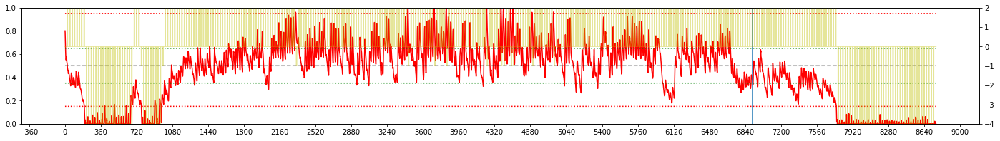


Iteration 39:  WAKKANAI, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  = -0.257
Day Violations           =    108
Battery Limit Violations =   1746
Action MEAN              =  3.972
Action STD DEV           =  2.949


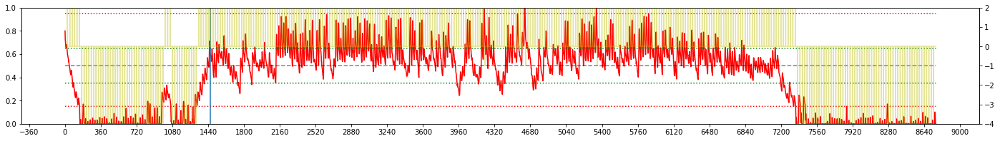


Iteration 40:  WAKKANAI, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  =  0.213
Day Violations           =     92
Battery Limit Violations =   1382
Action MEAN              =  3.993
Action STD DEV           =  3.026


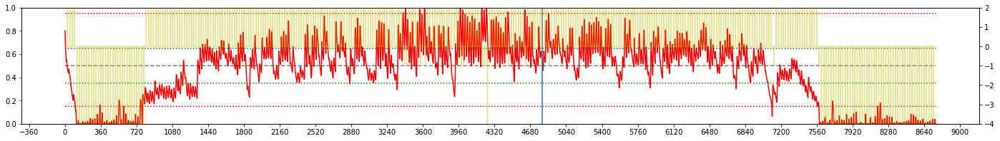


Iteration 41:  WAKKANAI, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  =  0.064
Day Violations           =     98
Battery Limit Violations =   1530
Action MEAN              =  4.031
Action STD DEV           =  3.089


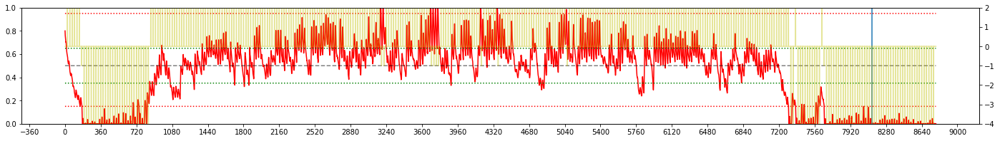


Iteration 42:  WAKKANAI, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  =  0.183
Day Violations           =     90
Battery Limit Violations =   1442
Action MEAN              =  4.178
Action STD DEV           =  3.017


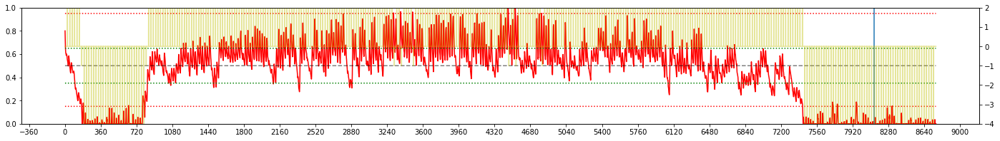


Iteration 43:  WAKKANAI, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  =  0.199
Day Violations           =     92
Battery Limit Violations =   1365
Action MEAN              =  3.974
Action STD DEV           =  3.017


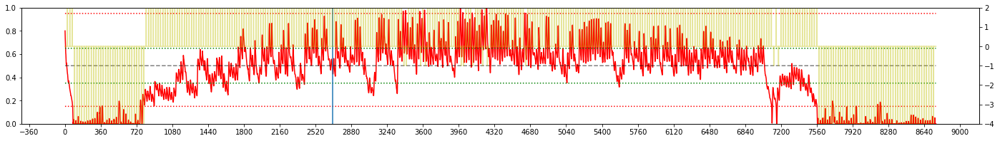


Iteration 44:  WAKKANAI, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  = -0.030
Day Violations           =    105
Battery Limit Violations =   1546
Action MEAN              =  4.123
Action STD DEV           =  3.023


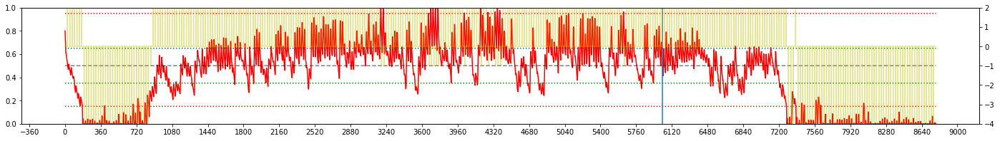


Iteration 45:  WAKKANAI, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  =  0.414
Day Violations           =     78
Battery Limit Violations =   1326
Action MEAN              =  3.754
Action STD DEV           =  2.873


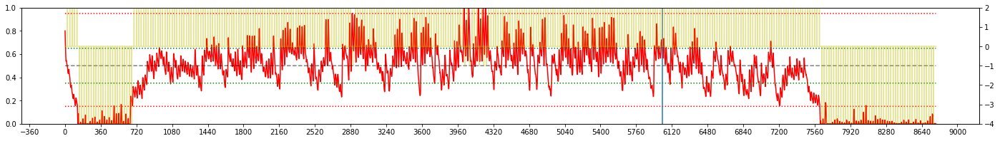


Iteration 46:  WAKKANAI, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  = -0.183
Day Violations           =    113
Battery Limit Violations =   1671
Action MEAN              =  4.053
Action STD DEV           =  3.074


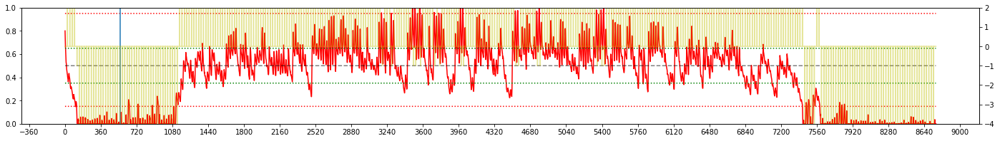


Iteration 47:  WAKKANAI, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  =  0.337
Day Violations           =     88
Battery Limit Violations =   1284
Action MEAN              =  3.757
Action STD DEV           =  2.908


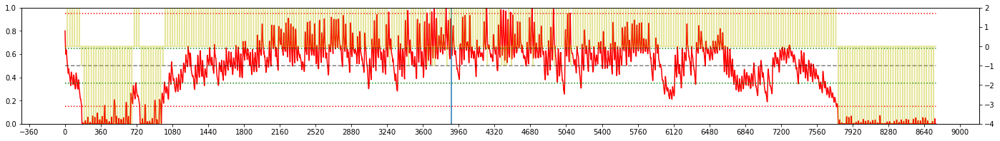


Iteration 48:  WAKKANAI, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  =  0.245
Day Violations           =     94
Battery Limit Violations =   1324
Action MEAN              =  3.760
Action STD DEV           =  3.116


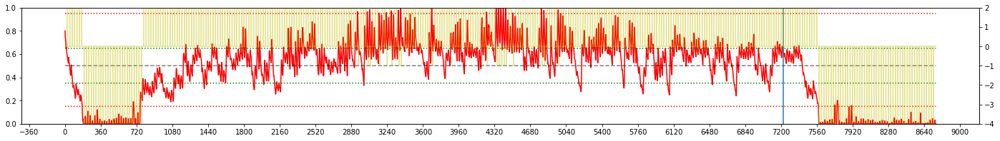


Iteration 49:  WAKKANAI, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  = -0.003
Day Violations           =    100
Battery Limit Violations =   1618
Action MEAN              =  4.063
Action STD DEV           =  3.173


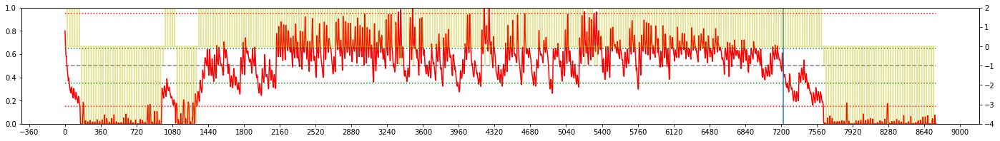


Iteration 50:  WAKKANAI, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  =  0.461
Day Violations           =     85
Battery Limit Violations =   1185
Action MEAN              =  3.697
Action STD DEV           =  3.018


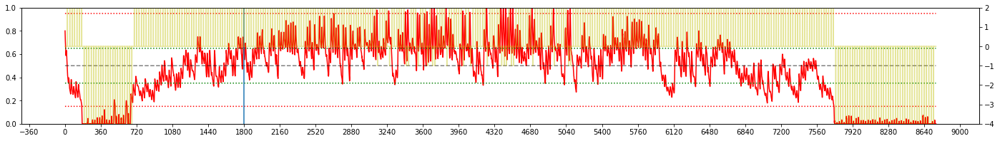


Iteration 51:  WAKKANAI, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  0.288
Day Violations           =     90
Battery Limit Violations =   1423
Action MEAN              =  3.999
Action STD DEV           =  3.227


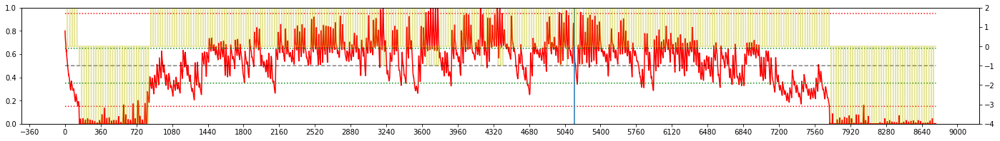


Iteration 52:  WAKKANAI, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  =  0.015
Day Violations           =    102
Battery Limit Violations =   1650
Action MEAN              =  4.067
Action STD DEV           =  3.181


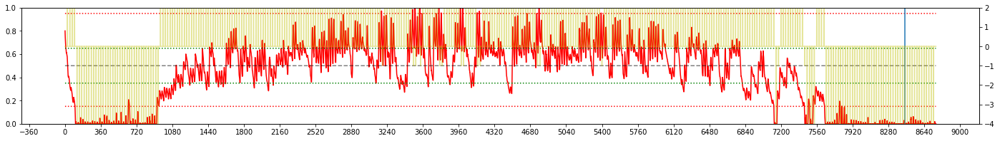


Iteration 53:  WAKKANAI, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  = -0.123
Day Violations           =    111
Battery Limit Violations =   1799
Action MEAN              =  4.240
Action STD DEV           =  3.348


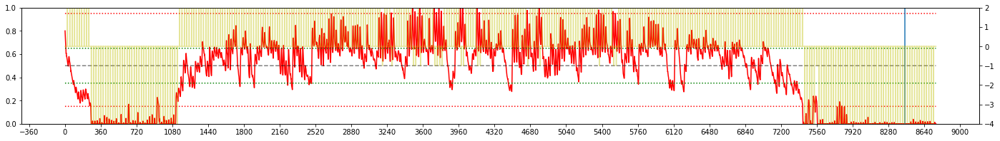


Iteration 54:  WAKKANAI, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  = -0.140
Day Violations           =    111
Battery Limit Violations =   1790
Action MEAN              =  4.220
Action STD DEV           =  3.380


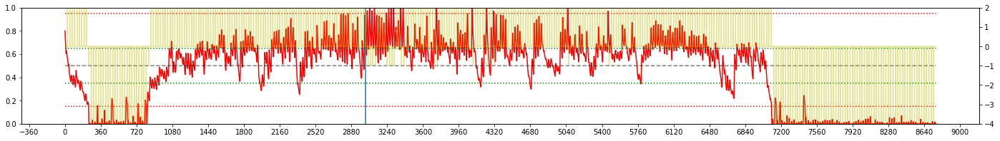


Iteration 55:  WAKKANAI, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  =  0.338
Day Violations           =     86
Battery Limit Violations =   1428
Action MEAN              =  3.943
Action STD DEV           =  3.284


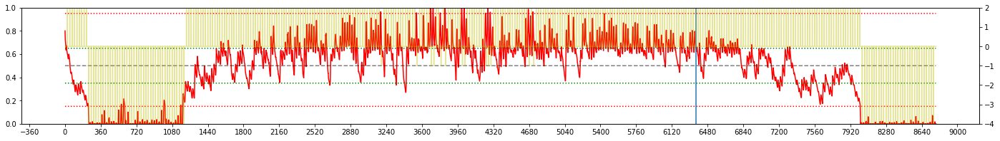


Iteration 56:  WAKKANAI, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  =  0.554
Day Violations           =     76
Battery Limit Violations =   1358
Action MEAN              =  4.060
Action STD DEV           =  3.454


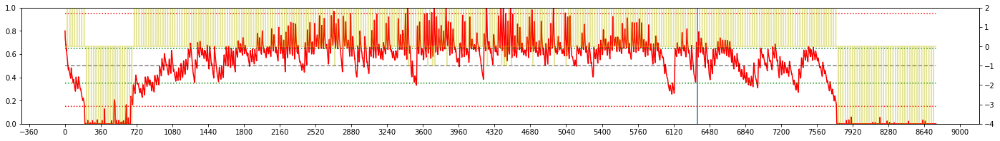


Iteration 57:  WAKKANAI, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  0.404
Day Violations           =     82
Battery Limit Violations =   1502
Action MEAN              =  3.918
Action STD DEV           =  3.230


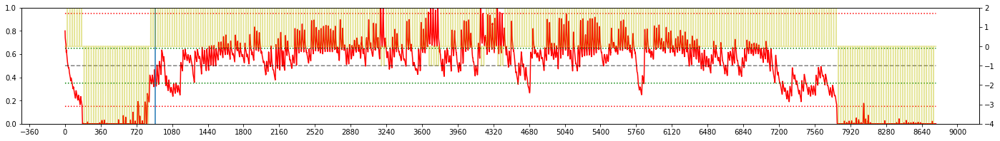


Iteration 58:  WAKKANAI, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  0.582
Day Violations           =     71
Battery Limit Violations =   1362
Action MEAN              =  4.040
Action STD DEV           =  3.496


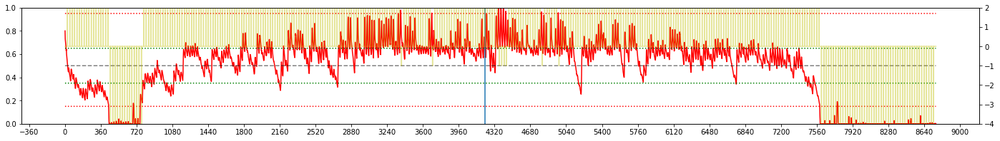


Iteration 59:  WAKKANAI, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  =  0.606
Day Violations           =     73
Battery Limit Violations =   1233
Action MEAN              =  3.821
Action STD DEV           =  3.376


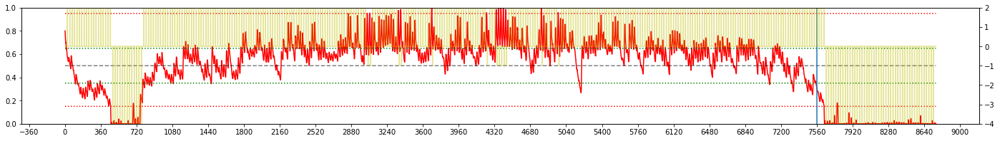


Iteration 60:  WAKKANAI, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  =  0.348
Day Violations           =     85
Battery Limit Violations =   1575
Action MEAN              =  4.146
Action STD DEV           =  3.504


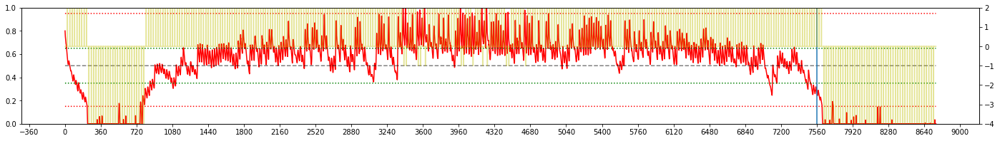


Iteration 61:  WAKKANAI, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  =  0.330
Day Violations           =     83
Battery Limit Violations =   1680
Action MEAN              =  4.153
Action STD DEV           =  3.488


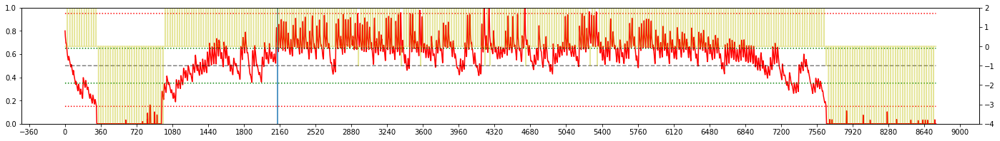


Iteration 62:  WAKKANAI, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  0.867
Day Violations           =     62
Battery Limit Violations =   1096
Action MEAN              =  3.564
Action STD DEV           =  3.167


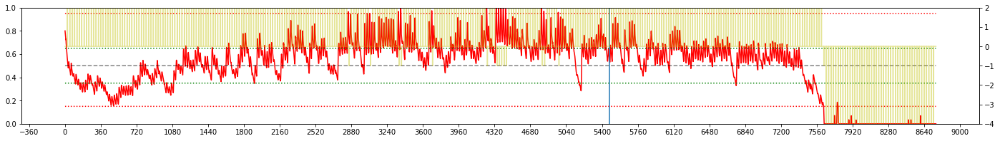


Iteration 63:  WAKKANAI, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  0.844
Day Violations           =     60
Battery Limit Violations =   1132
Action MEAN              =  4.128
Action STD DEV           =  3.562


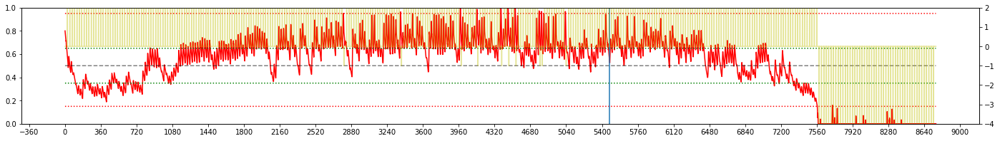


Iteration 64:  WAKKANAI, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  0.351
Day Violations           =     86
Battery Limit Violations =   1475
Action MEAN              =  3.633
Action STD DEV           =  3.279


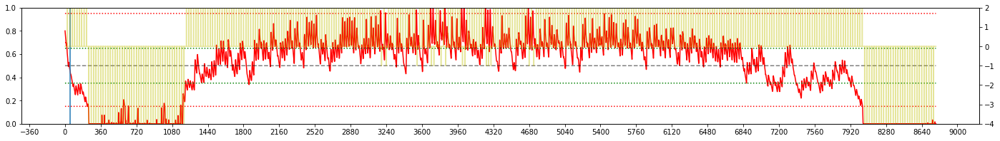


Iteration 65:  WAKKANAI, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  0.294
Day Violations           =     91
Battery Limit Violations =   1623
Action MEAN              =  3.709
Action STD DEV           =  3.278


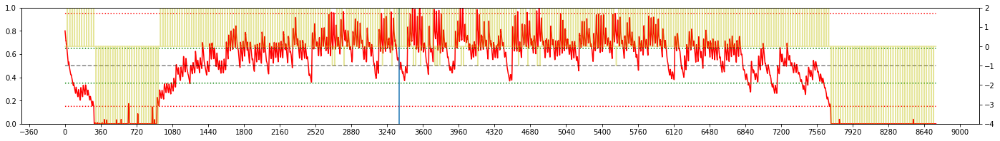


Iteration 66:  WAKKANAI, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  0.568
Day Violations           =     76
Battery Limit Violations =   1416
Action MEAN              =  3.856
Action STD DEV           =  3.266


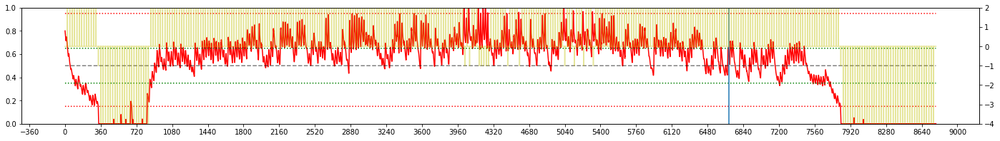


Iteration 67:  WAKKANAI, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  0.958
Day Violations           =     68
Battery Limit Violations =    793
Action MEAN              =  3.543
Action STD DEV           =  3.318


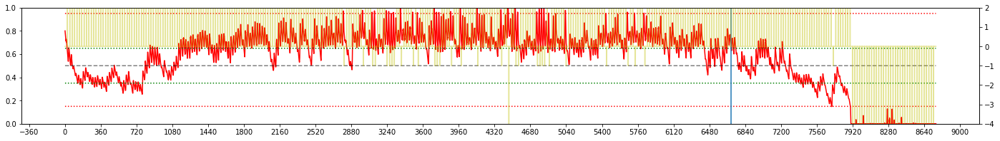


Iteration 68:  WAKKANAI, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  1.014
Day Violations           =     64
Battery Limit Violations =    811
Action MEAN              =  3.838
Action STD DEV           =  3.464


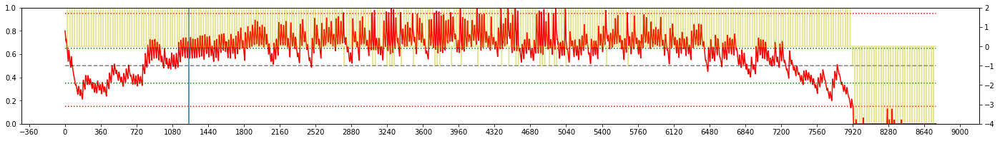


Iteration 69:  WAKKANAI, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  0.493
Day Violations           =     86
Battery Limit Violations =   1329
Action MEAN              =  3.696
Action STD DEV           =  3.350


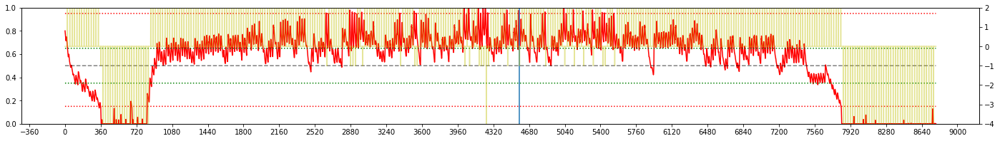


Iteration 70:  WAKKANAI, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  0.418
Day Violations           =     95
Battery Limit Violations =   1338
Action MEAN              =  3.717
Action STD DEV           =  3.357


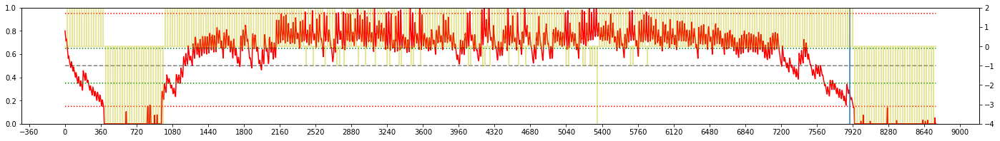


Iteration 71:  WAKKANAI, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  0.985
Day Violations           =     72
Battery Limit Violations =    712
Action MEAN              =  3.262
Action STD DEV           =  3.178


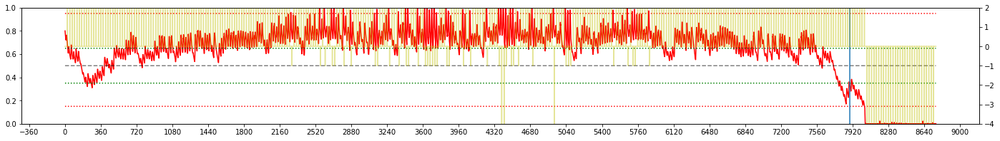


Iteration 72:  WAKKANAI, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  0.715
Day Violations           =     87
Battery Limit Violations =    864
Action MEAN              =  3.385
Action STD DEV           =  3.315


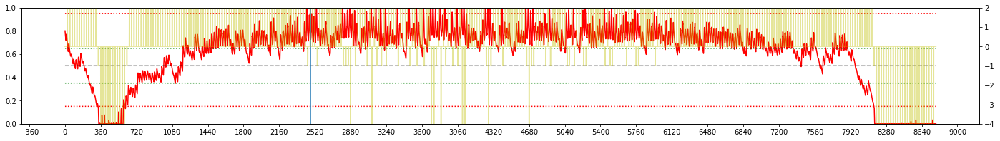


Iteration 73:  WAKKANAI, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  1.029
Day Violations           =     77
Battery Limit Violations =    557
Action MEAN              =  3.448
Action STD DEV           =  3.344


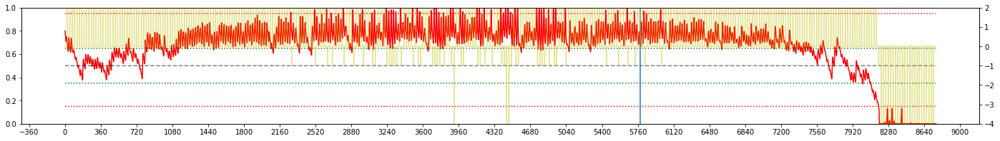


Iteration 74:  WAKKANAI, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  0.747
Day Violations           =     95
Battery Limit Violations =    619
Action MEAN              =  3.367
Action STD DEV           =  3.495


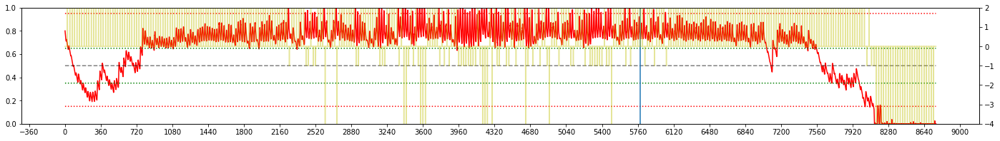


Iteration 75:  WAKKANAI, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  =  0.669
Day Violations           =     94
Battery Limit Violations =    926
Action MEAN              =  3.315
Action STD DEV           =  3.394


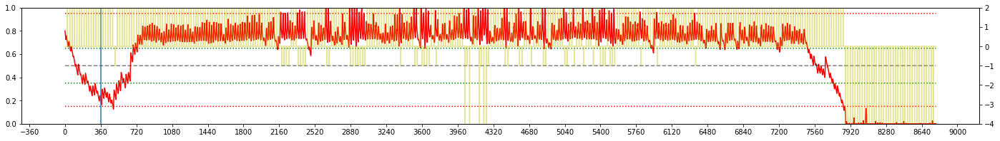


Iteration 76:  WAKKANAI, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  =  0.842
Day Violations           =     85
Battery Limit Violations =    651
Action MEAN              =  3.308
Action STD DEV           =  3.434


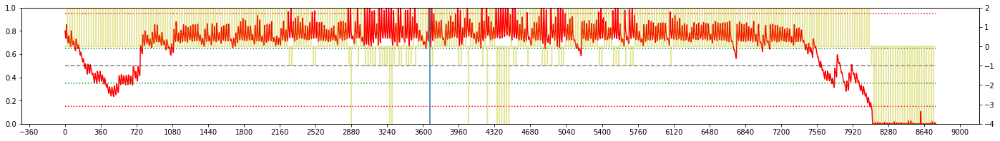


Iteration 77:  WAKKANAI, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  =  0.808
Day Violations           =     97
Battery Limit Violations =    664
Action MEAN              =  3.090
Action STD DEV           =  3.399


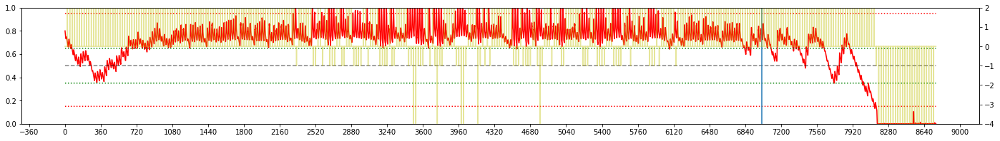


Iteration 78:  WAKKANAI, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  0.730
Day Violations           =     98
Battery Limit Violations =    709
Action MEAN              =  3.236
Action STD DEV           =  3.414


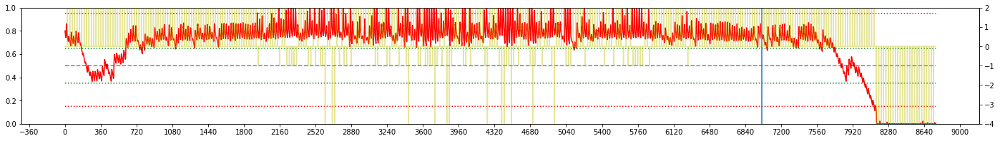


Iteration 79:  WAKKANAI, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  0.840
Day Violations           =     92
Battery Limit Violations =    519
Action MEAN              =  3.082
Action STD DEV           =  3.461


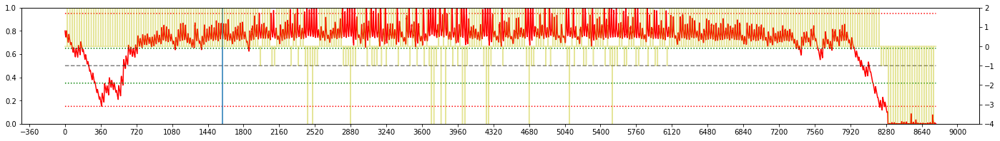


Iteration 80:  WAKKANAI, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  1.017
Day Violations           =     86
Battery Limit Violations =    171
Action MEAN              =  3.074
Action STD DEV           =  3.492


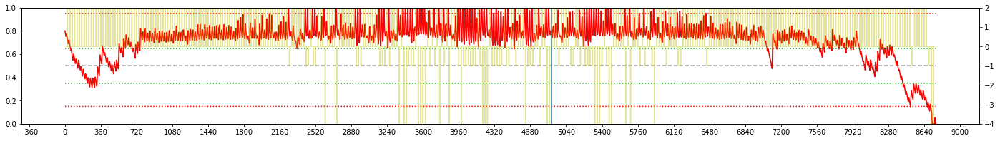


Iteration 81:  WAKKANAI, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  1.021
Day Violations           =     81
Battery Limit Violations =    152
Action MEAN              =  3.042
Action STD DEV           =  3.551


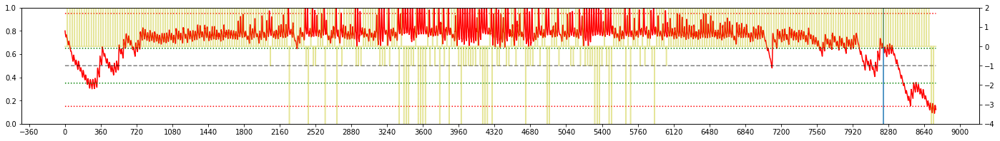


Iteration 82:  WAKKANAI, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  0.607
Day Violations           =    102
Battery Limit Violations =    552
Action MEAN              =  2.982
Action STD DEV           =  3.485


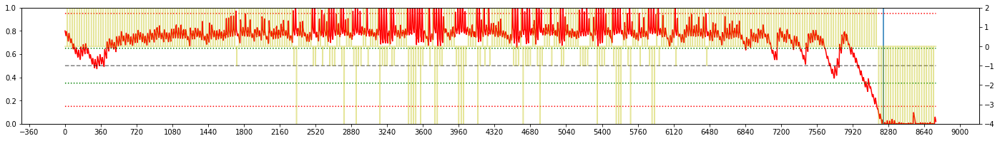


Iteration 83:  WAKKANAI, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  0.628
Day Violations           =     91
Battery Limit Violations =    663
Action MEAN              =  3.099
Action STD DEV           =  3.515


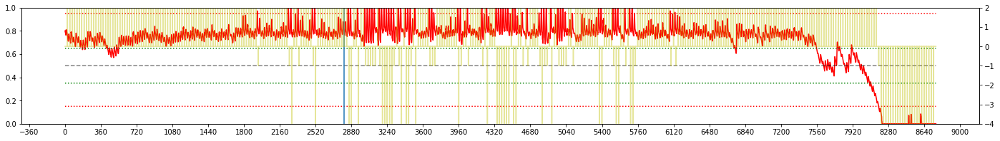


Iteration 84:  WAKKANAI, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  0.658
Day Violations           =     97
Battery Limit Violations =    330
Action MEAN              =  2.910
Action STD DEV           =  3.527


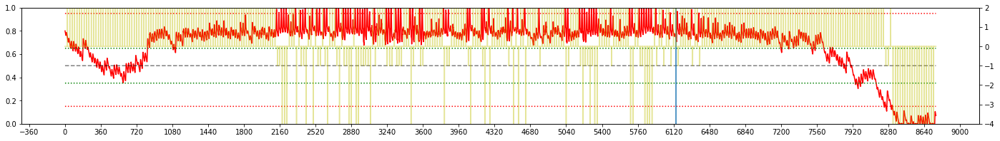


Iteration 85:  WAKKANAI, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  0.675
Day Violations           =     98
Battery Limit Violations =    359
Action MEAN              =  3.290
Action STD DEV           =  3.793


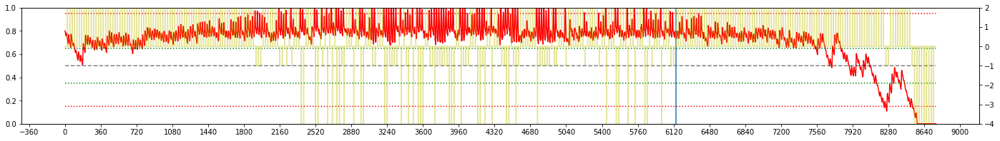


Iteration 86:  WAKKANAI, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  0.616
Day Violations           =     99
Battery Limit Violations =    326
Action MEAN              =  3.198
Action STD DEV           =  3.803


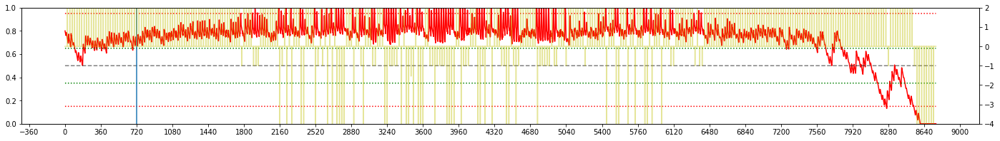


Iteration 87:  WAKKANAI, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  0.608
Day Violations           =     98
Battery Limit Violations =    430
Action MEAN              =  2.934
Action STD DEV           =  3.583


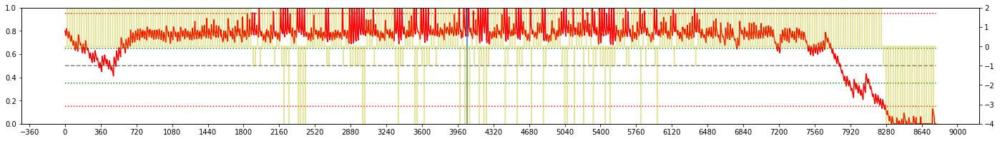


Iteration 88:  WAKKANAI, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  0.710
Day Violations           =     99
Battery Limit Violations =    224
Action MEAN              =  2.995
Action STD DEV           =  3.687


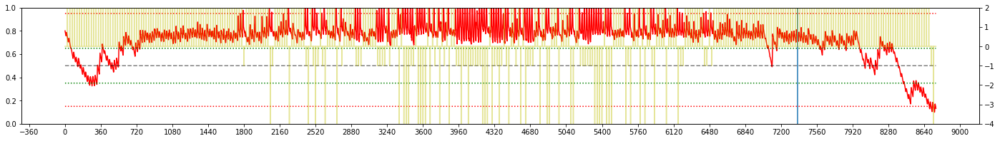


Iteration 89:  WAKKANAI, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  =  0.585
Day Violations           =    102
Battery Limit Violations =    381
Action MEAN              =  2.898
Action STD DEV           =  3.562


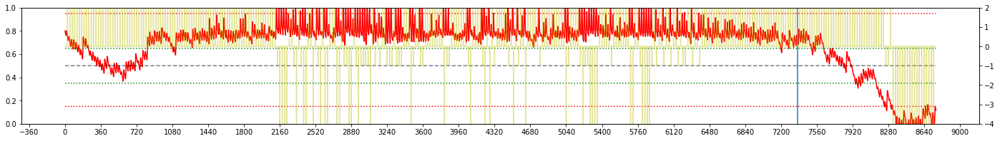


Iteration 90:  WAKKANAI, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  0.542
Day Violations           =    106
Battery Limit Violations =    588
Action MEAN              =  3.122
Action STD DEV           =  3.653


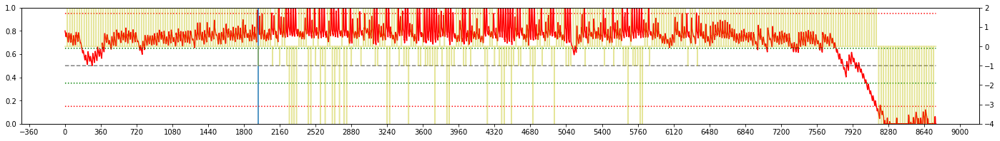


Iteration 91:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  1.008
Day Violations           =     91
Battery Limit Violations =    197
Action MEAN              =  3.014
Action STD DEV           =  3.696


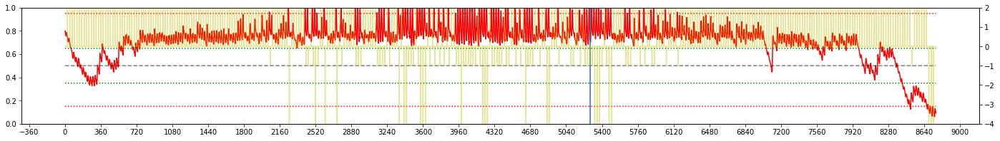


Iteration 92:  WAKKANAI, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  0.667
Day Violations           =    103
Battery Limit Violations =    518
Action MEAN              =  3.101
Action STD DEV           =  3.663


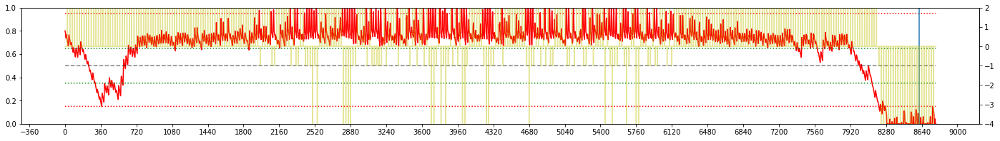


Iteration 93:  WAKKANAI, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  =  0.642
Day Violations           =    111
Battery Limit Violations =    693
Action MEAN              =  3.034
Action STD DEV           =  3.466


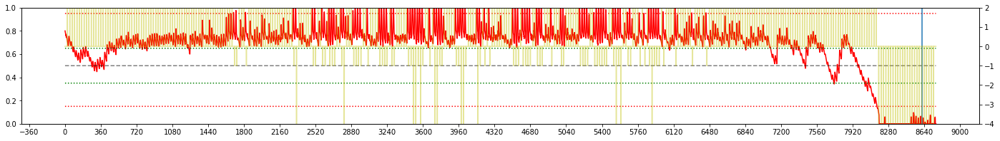


Iteration 94:  WAKKANAI, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  0.776
Day Violations           =    102
Battery Limit Violations =    507
Action MEAN              =  2.870
Action STD DEV           =  3.366


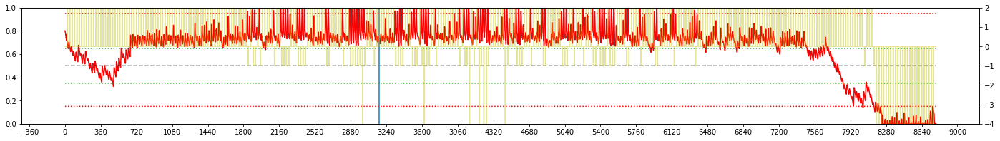


Iteration 95:  WAKKANAI, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  0.749
Day Violations           =    108
Battery Limit Violations =    468
Action MEAN              =  2.989
Action STD DEV           =  3.279


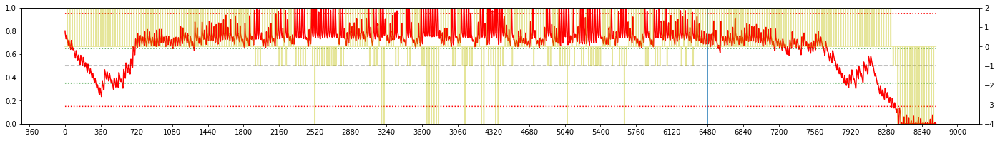


Iteration 96:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  1.011
Day Violations           =    103
Battery Limit Violations =    296
Action MEAN              =  2.990
Action STD DEV           =  3.147


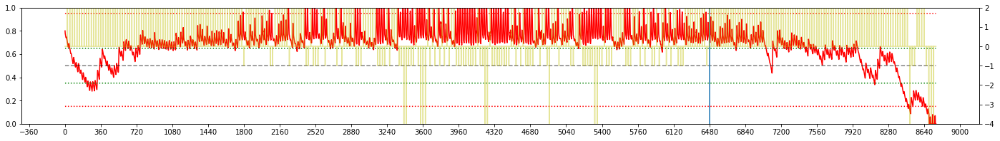


Iteration 97:  WAKKANAI, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  0.825
Day Violations           =     99
Battery Limit Violations =    559
Action MEAN              =  2.963
Action STD DEV           =  2.984


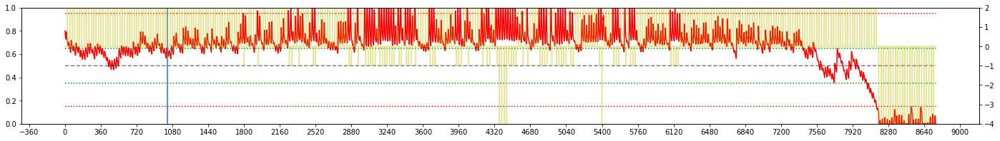


Iteration 98:  WAKKANAI, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  =  0.450
Day Violations           =    123
Battery Limit Violations =    796
Action MEAN              =  3.248
Action STD DEV           =  3.272


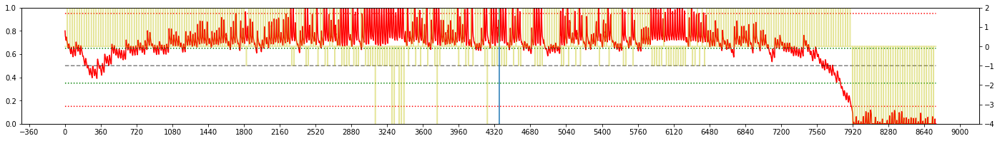


Iteration 99:  WAKKANAI, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  0.797
Day Violations           =    103
Battery Limit Violations =    508
Action MEAN              =  2.939
Action STD DEV           =  2.939


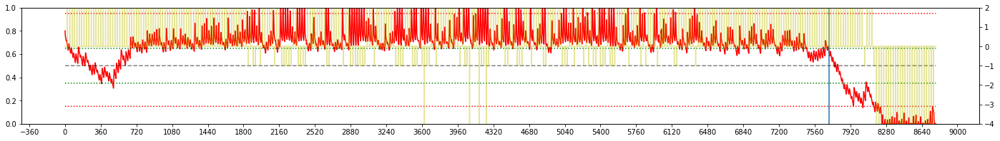

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'wakkanai'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset(batt=0.8*capm.BMAX)
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.good_memory_counter > MEMORY_CAPACITY and dqn.bad_memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
    ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:20:11.250866



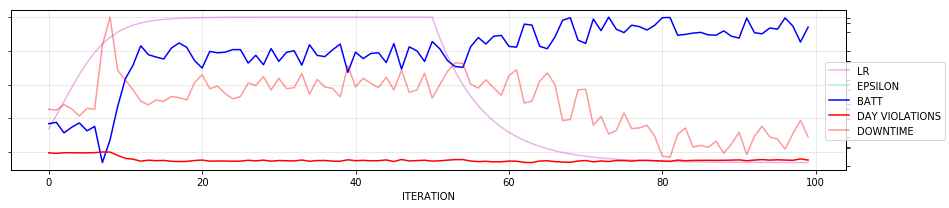

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_B1_2_wakkanai_alt_depth2_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


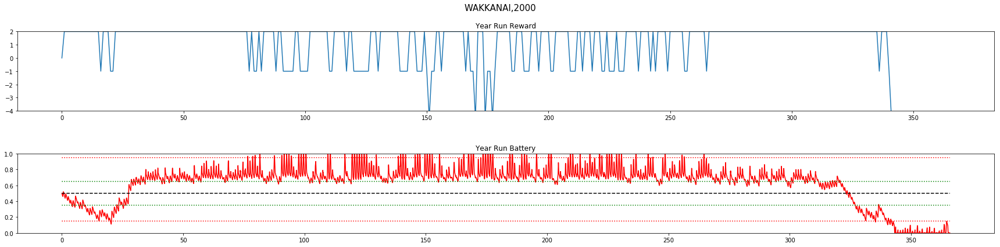

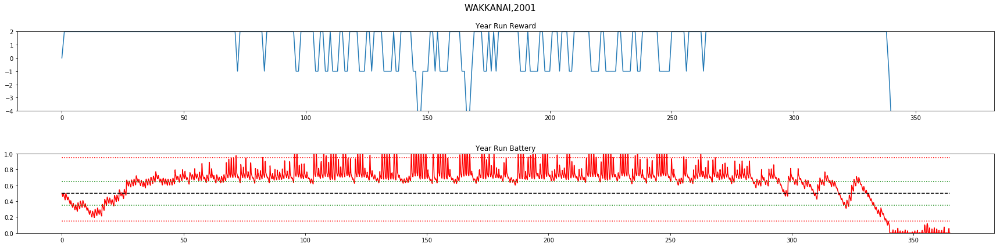

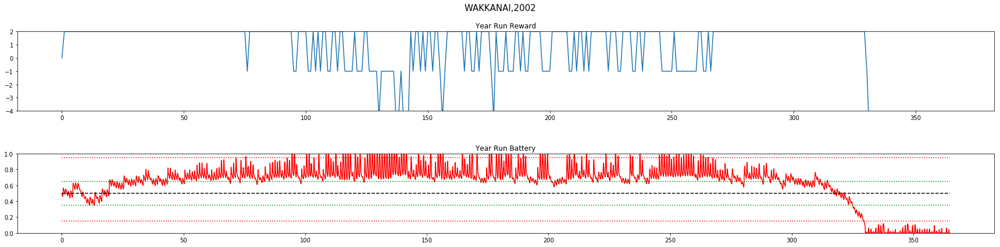

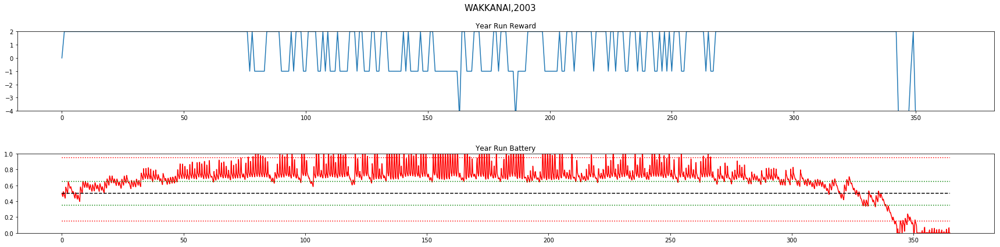

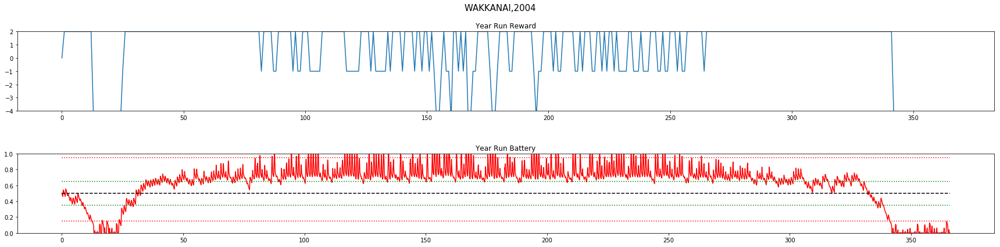

...

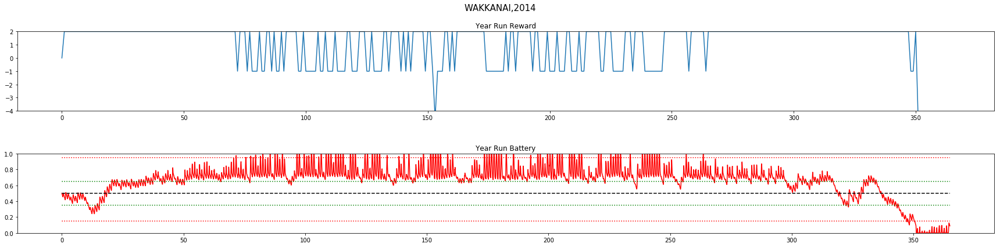

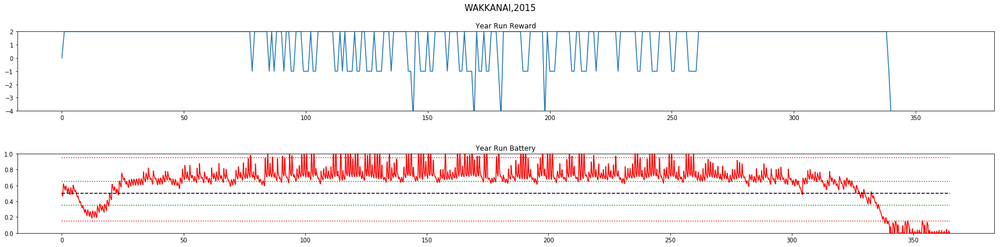

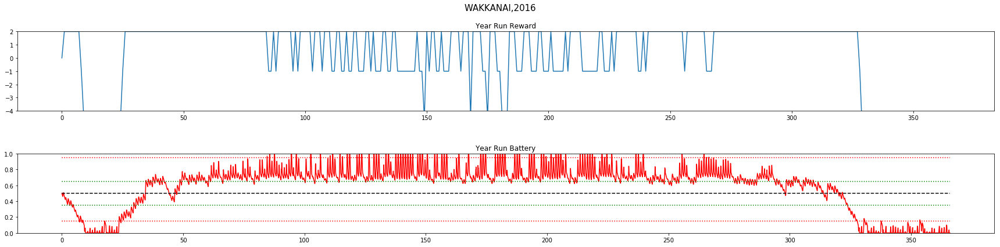

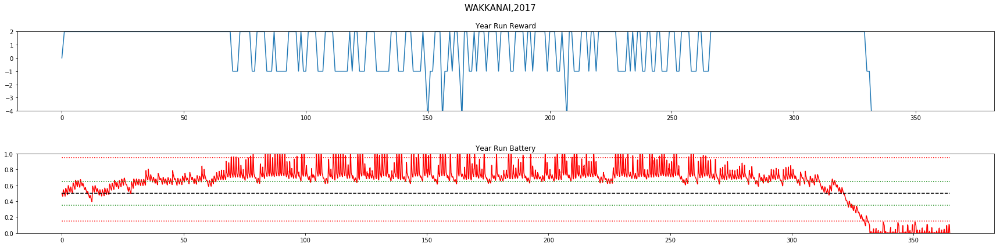

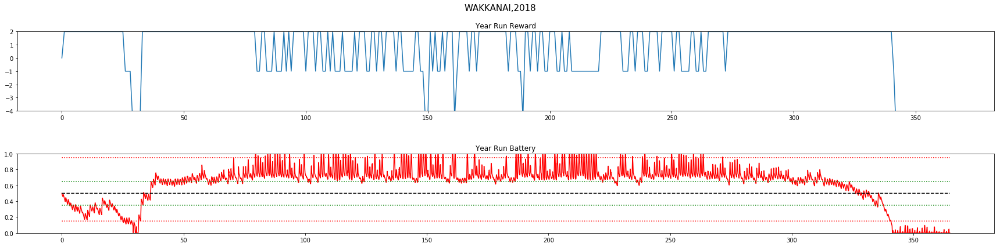



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.78		105	 508
2001	 0.76		106	 628
2002	 0.45		124	 766
2003	 0.74		120	 493
2004	 0.49		118	 714
2005	 0.78		116	 447
2006	 0.84		98	 559
2007	 0.72		108	 654
2008	 0.54		123	 581
2009	 0.51		125	 611
2010	 0.95		92	 472
2011	 0.65		104	 691
2012	 0.55		119	 705
2013	 0.7		111	 528
2014	 0.92		108	 459
2015	 0.83		99	 508
2016	 0.12		139	 968
2017	 0.48		128	 712
2018	 0.64		118	 621

TOTAL Day Violations:   2161.0
TOTAL Batt Violations:  11625.0
************************************


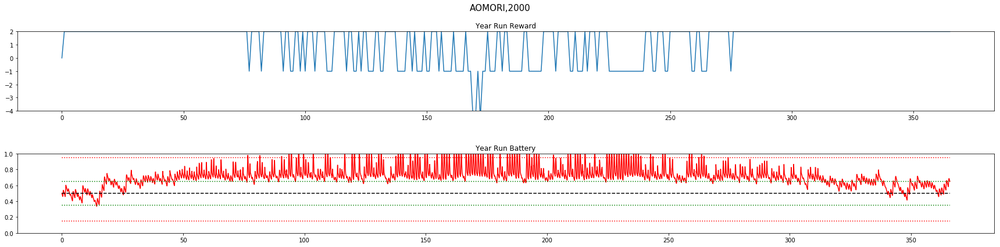

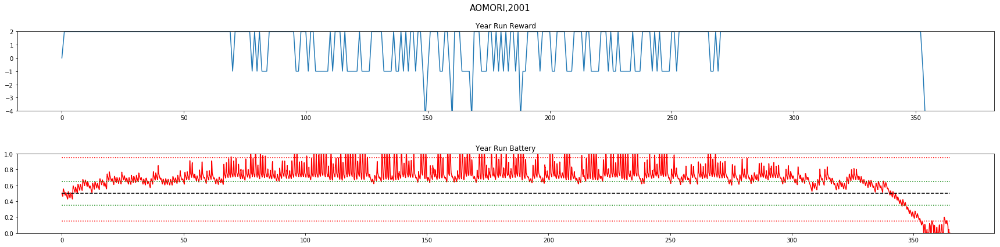

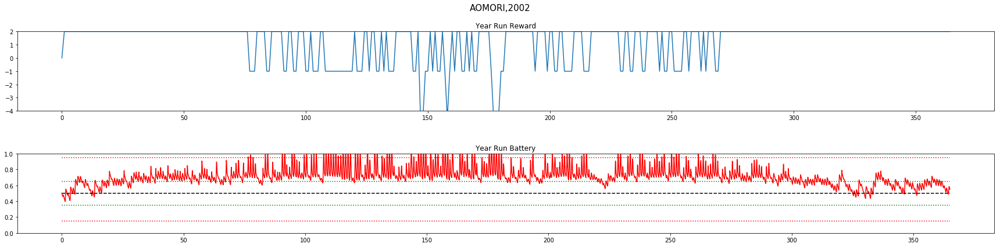

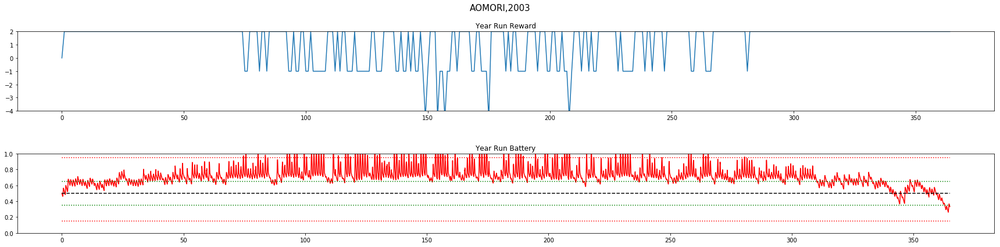

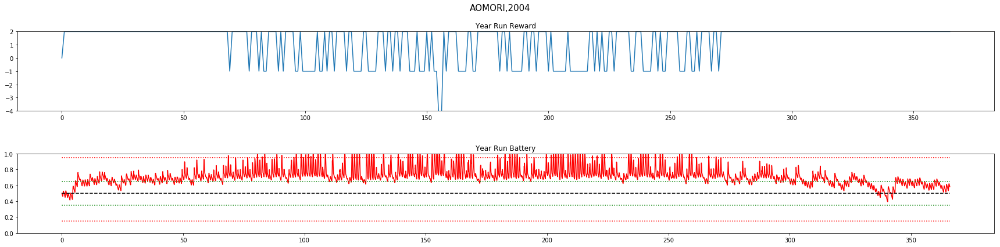

...

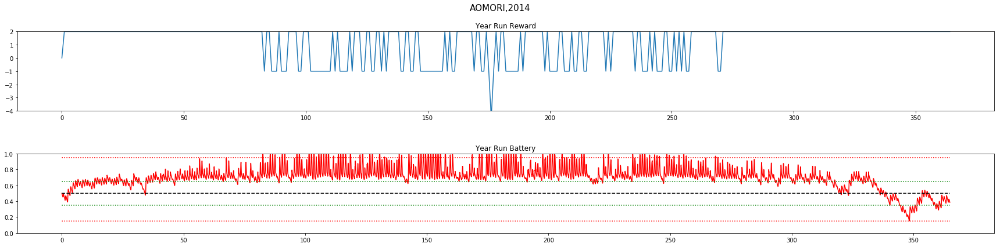

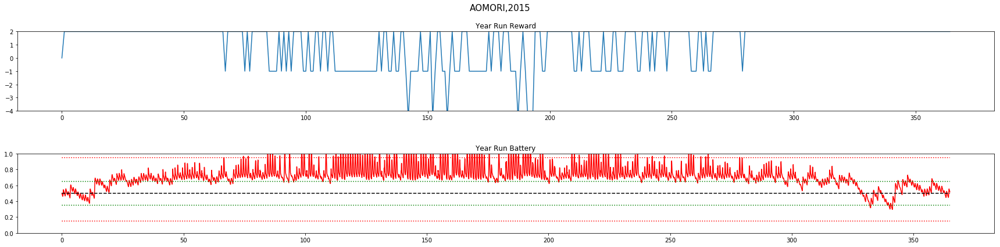

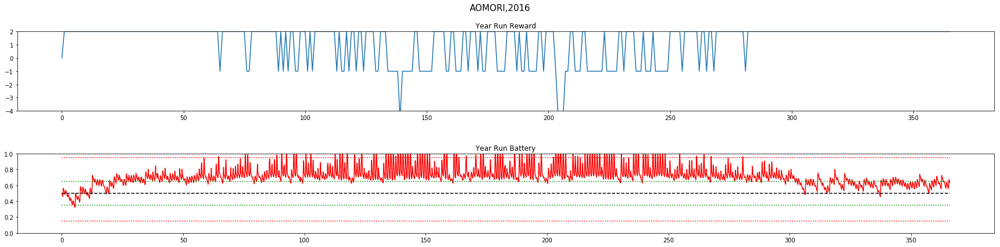

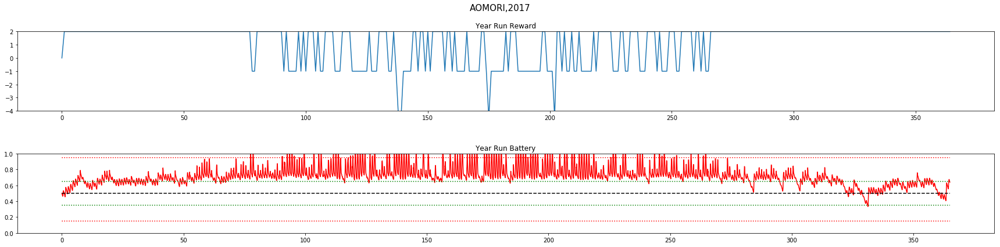

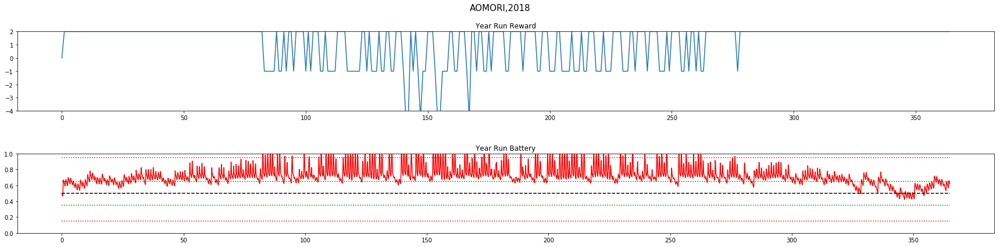



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.18		96	 247
2001	 0.98		103	 359
2002	 1.2		89	 219
2003	 1.23		87	 213
2004	 1.2		95	 204
2005	 1.25		86	 214
2006	 1.26		89	 201
2007	 1.11		99	 278
2008	 1.11		102	 272
2009	 1.22		94	 216
2010	 1.22		89	 211
2011	 1.24		90	 212
2012	 1.07		102	 282
2013	 1.25		87	 193
2014	 1.24		91	 221
2015	 1.07		104	 263
2016	 1.18		95	 261
2017	 1.13		100	 272
2018	 1.18		92	 232

TOTAL Day Violations:   1790.0
TOTAL Batt Violations:  4570.0
************************************


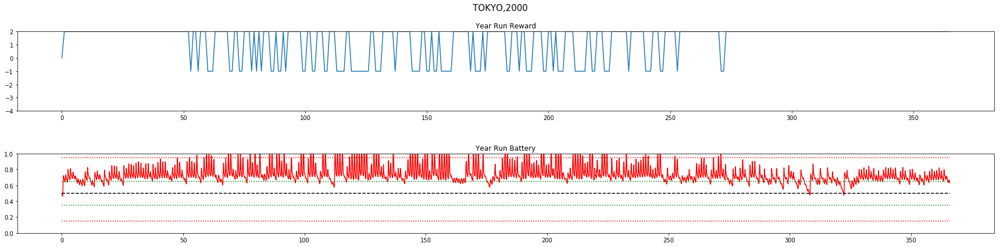

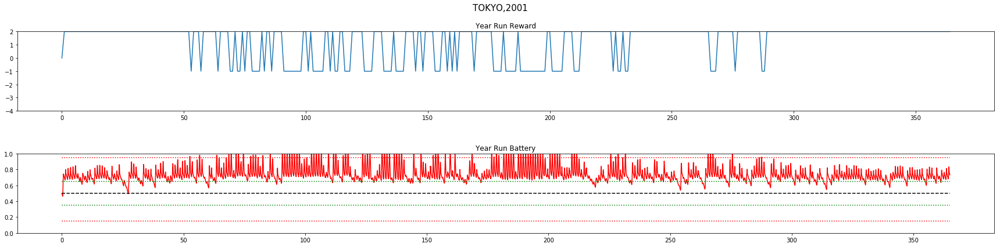

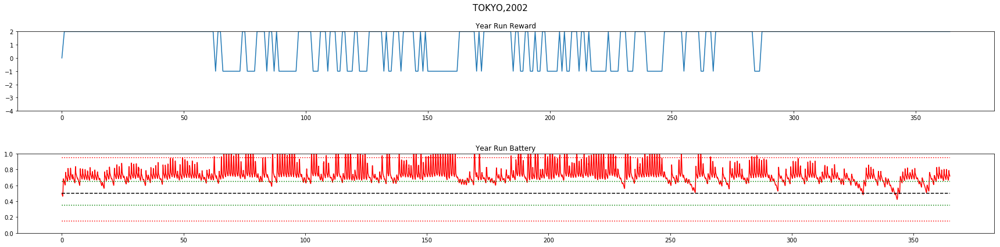

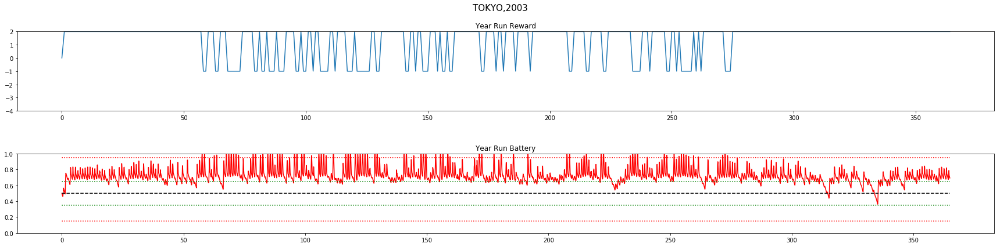

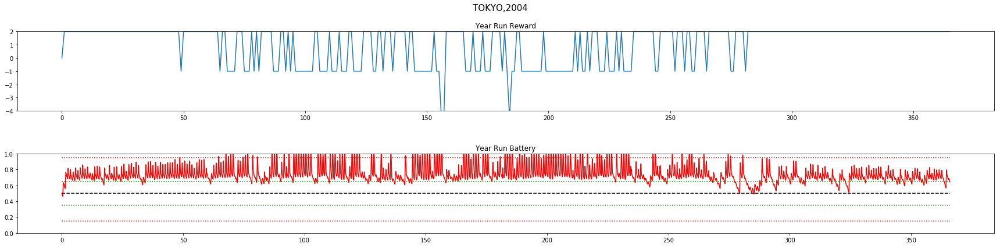

...

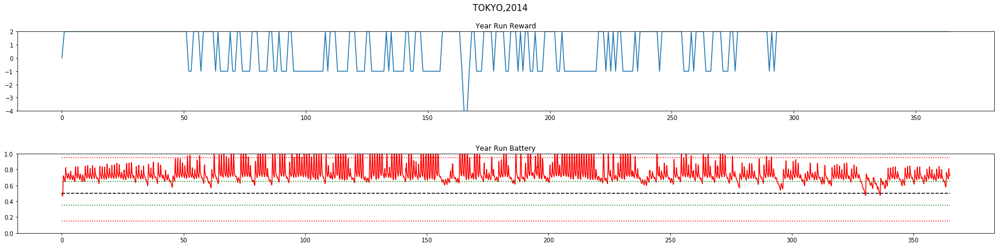

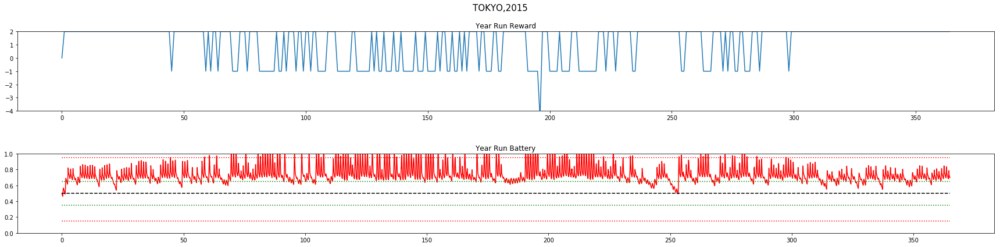

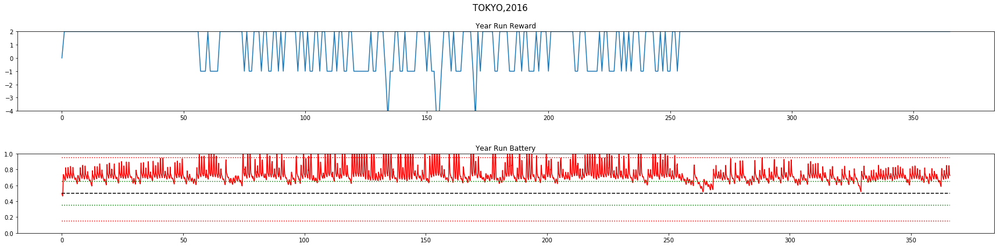

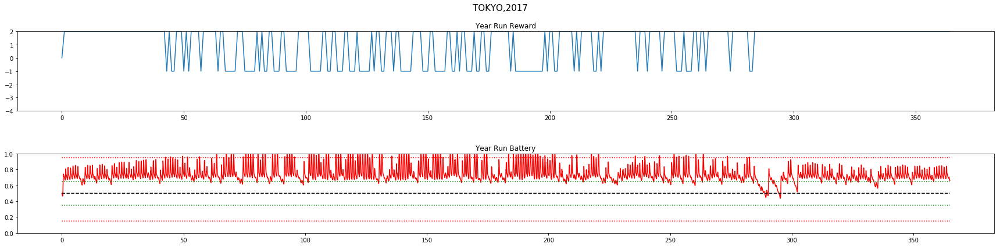

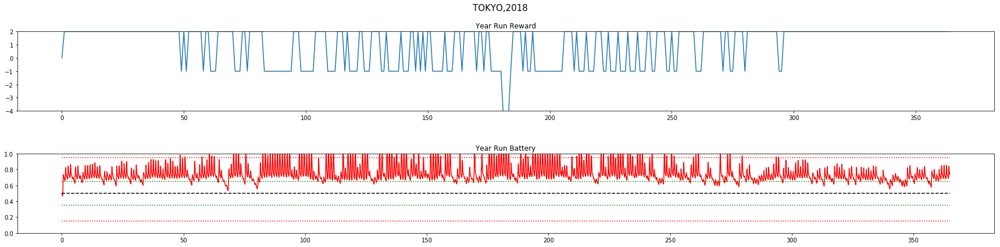



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.27		88	 224
2001	 1.22		94	 206
2002	 1.15		103	 227
2003	 1.32		82	 160
2004	 1.02		115	 284
2005	 1.16		101	 196
2006	 1.47		64	 152
2007	 1.12		104	 222
2008	 1.21		96	 175
2009	 1.3		85	 198
2010	 1.09		109	 254
2011	 1.1		105	 252
2012	 0.98		122	 265
2013	 0.94		128	 283
2014	 0.96		124	 293
2015	 1.07		111	 239
2016	 1.21		91	 214
2017	 1.11		108	 213
2018	 0.95		124	 301

TOTAL Day Violations:   1954.0
TOTAL Batt Violations:  4358.0
************************************


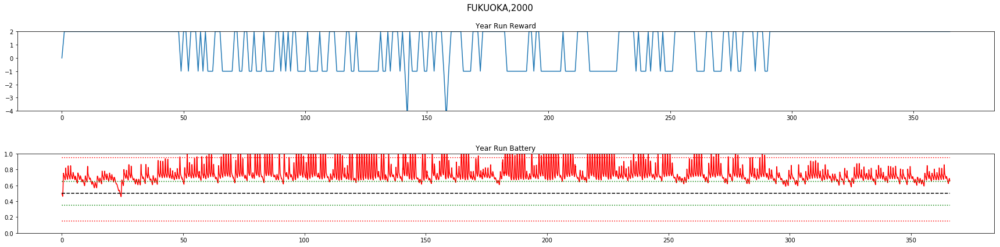

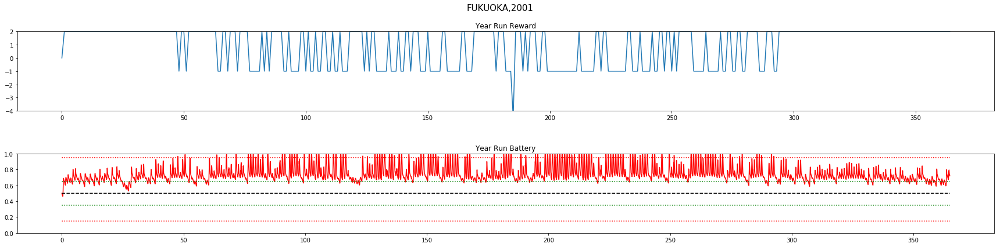

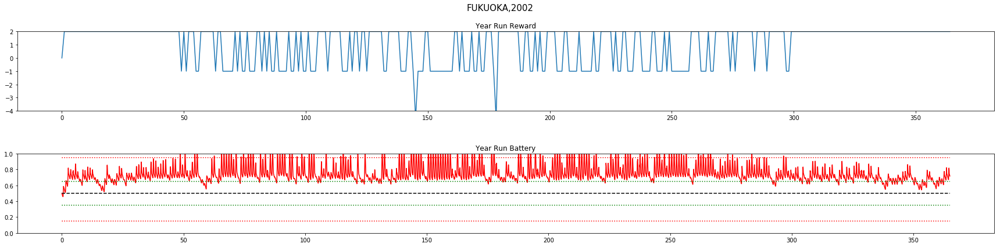

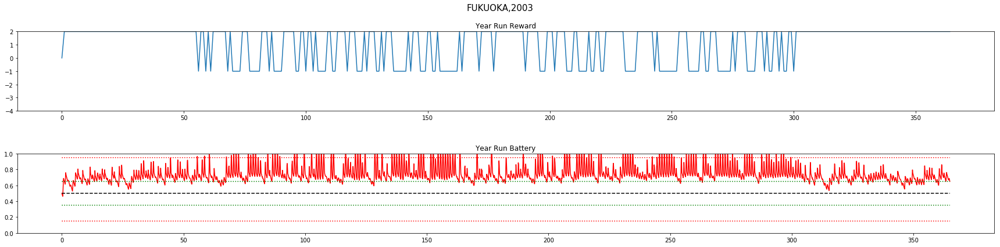

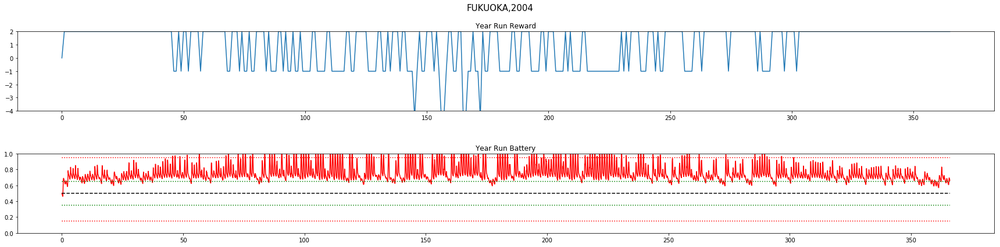

...

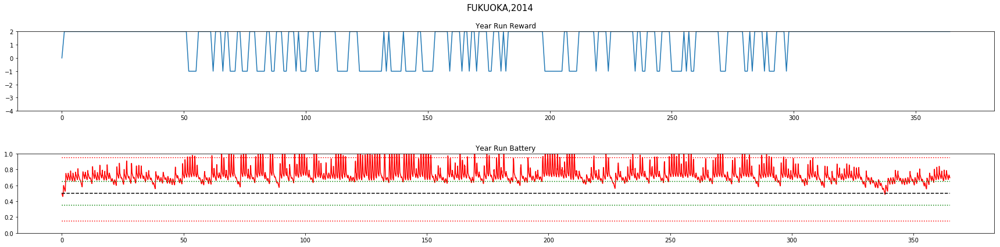

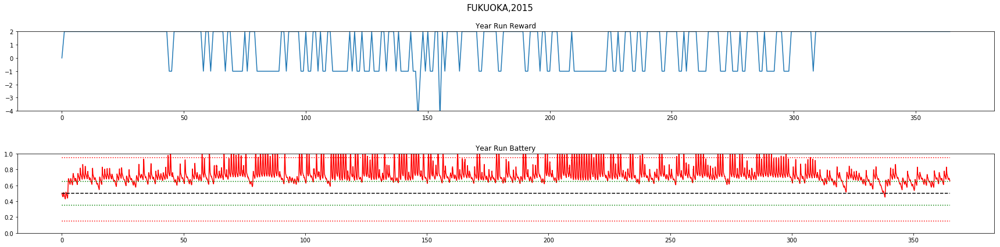

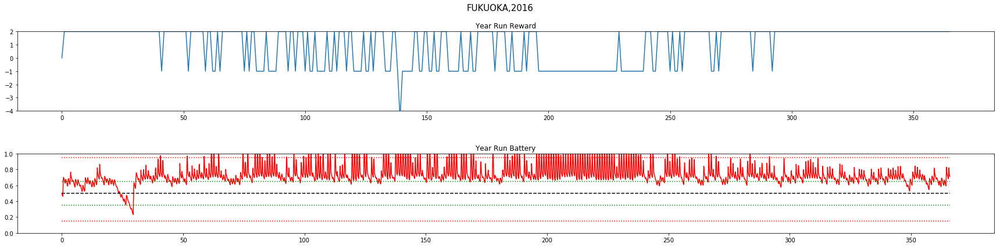

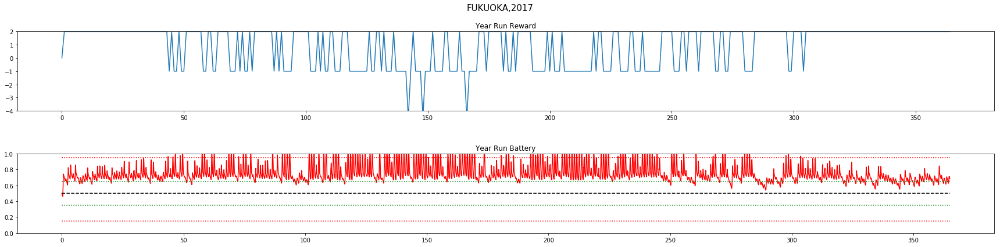

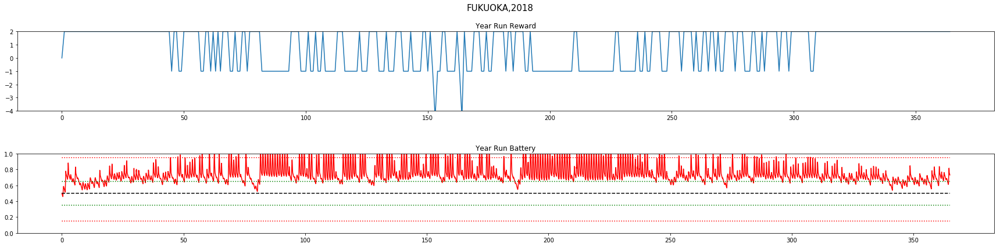



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.89		132	 357
2001	 0.91		131	 313
2002	 0.96		123	 313
2003	 1.06		114	 267
2004	 0.92		124	 286
2005	 0.93		127	 317
2006	 1.06		114	 261
2007	 0.9		133	 313
2008	 0.96		125	 263
2009	 1.1		109	 302
2010	 1.1		108	 266
2011	 1.16		101	 223
2012	 1.21		96	 227
2013	 0.94		127	 291
2014	 1.15		103	 197
2015	 0.96		124	 310
2016	 0.97		124	 319
2017	 0.85		136	 354
2018	 0.78		146	 389

TOTAL Day Violations:   2297.0
TOTAL Batt Violations:  5568.0
************************************


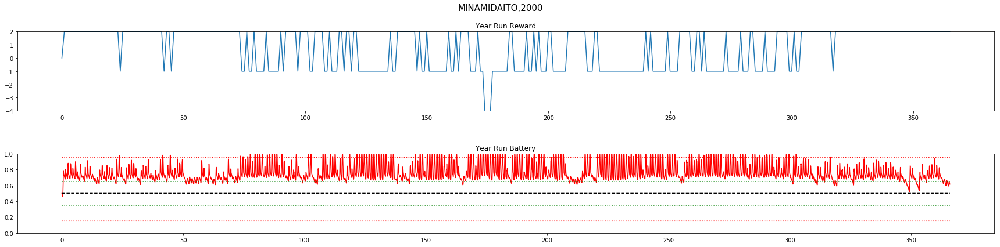

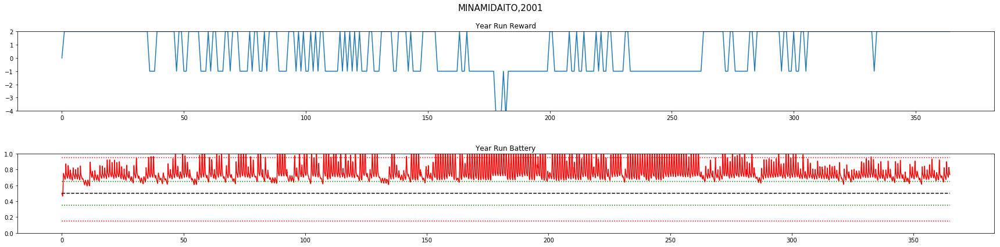

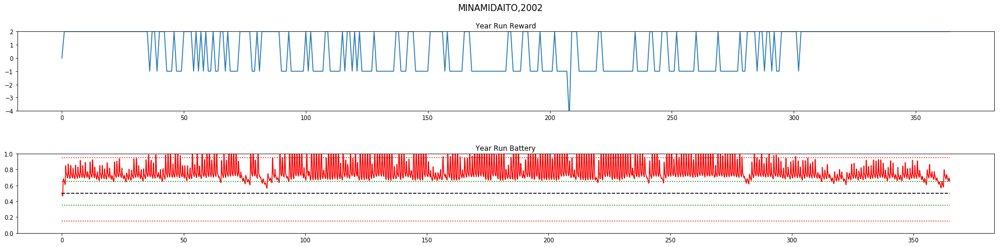

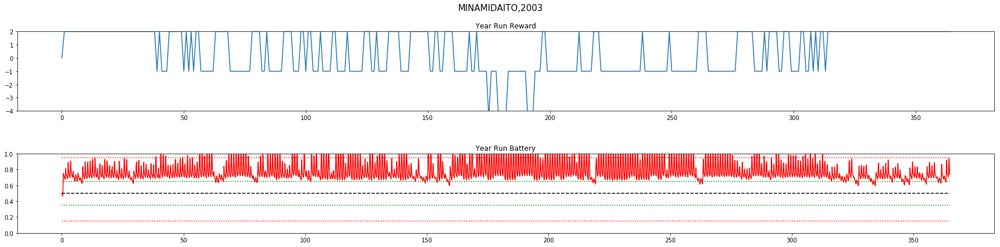

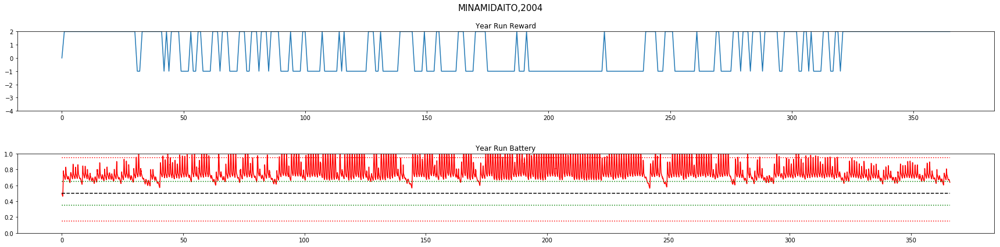

...

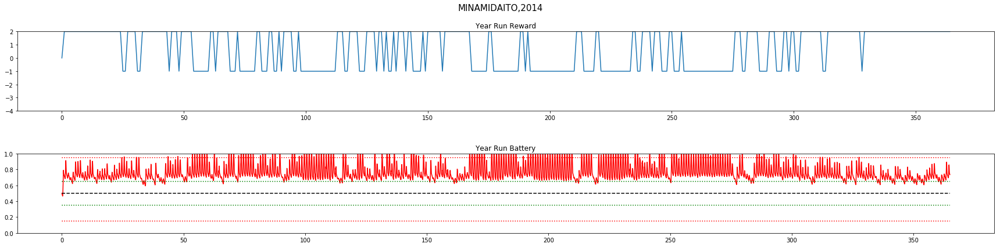

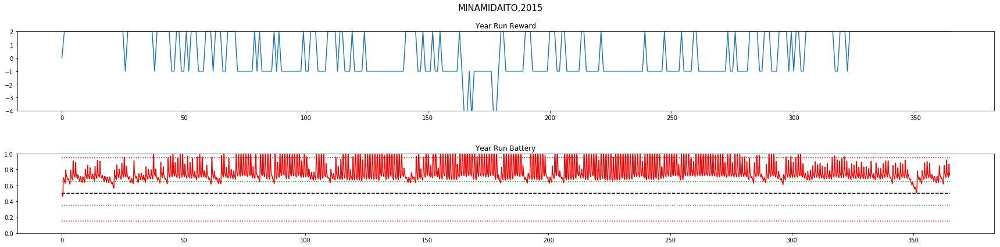

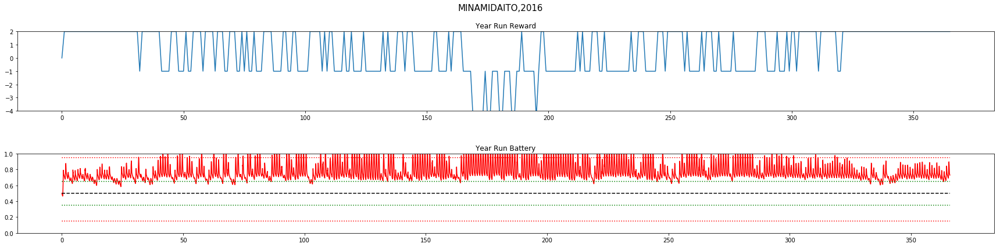

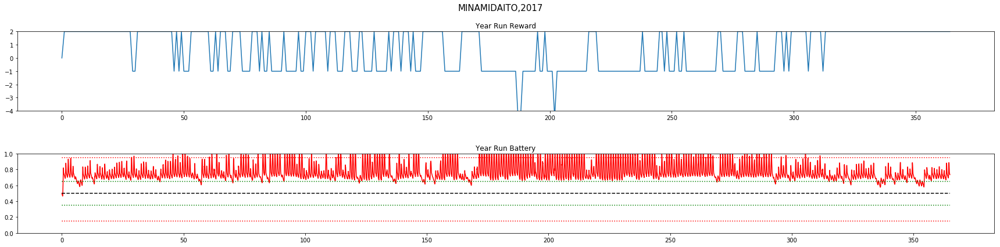

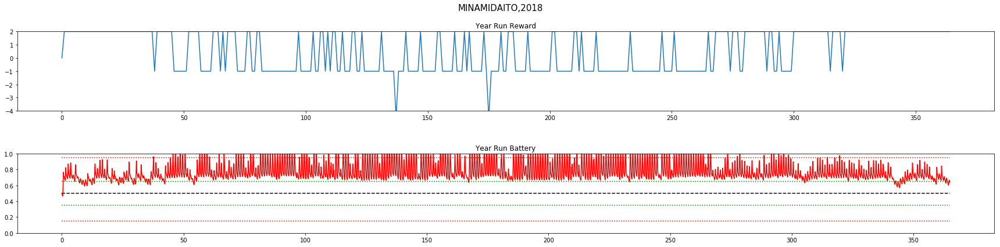



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.71		153	 406
2001	 0.58		167	 457
2002	 0.57		172	 481
2003	 0.41		183	 523
2004	 0.5		182	 453
2005	 0.64		165	 431
2006	 0.43		184	 488
2007	 0.64		163	 433
2008	 0.62		168	 431
2009	 0.52		180	 493
2010	 0.59		167	 435
2011	 0.62		165	 448
2012	 0.79		147	 353
2013	 0.5		181	 442
2014	 0.64		165	 420
2015	 0.38		190	 514
2016	 0.46		173	 481
2017	 0.58		168	 463
2018	 0.46		184	 541

TOTAL Day Violations:   3257.0
TOTAL Batt Violations:  8693.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:24:18.704072


In [24]:
LOCATION = 'tokyo'
YEAR = 2000

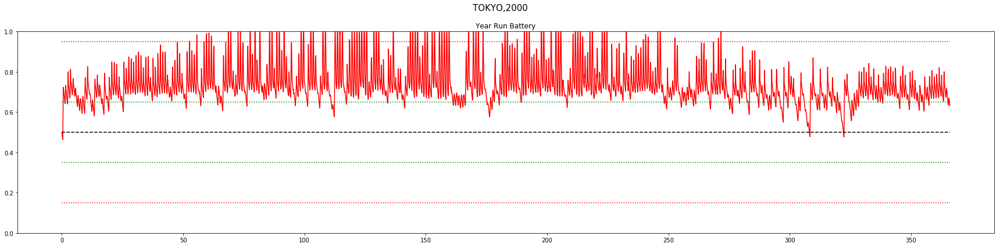

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 320
DAY_END   = 325

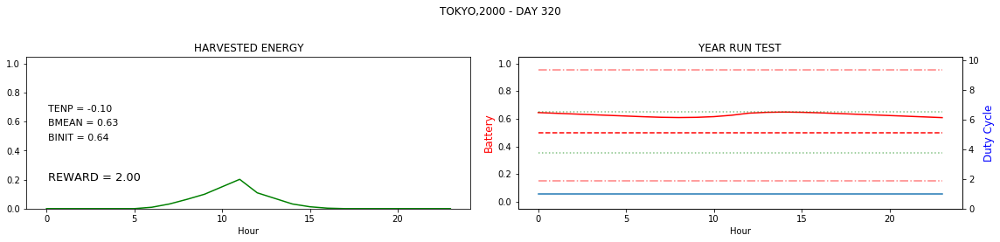

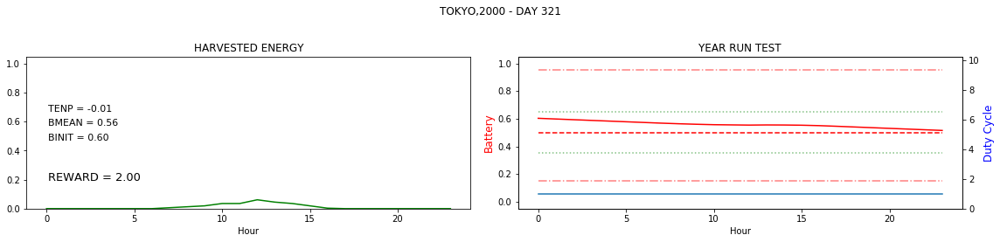

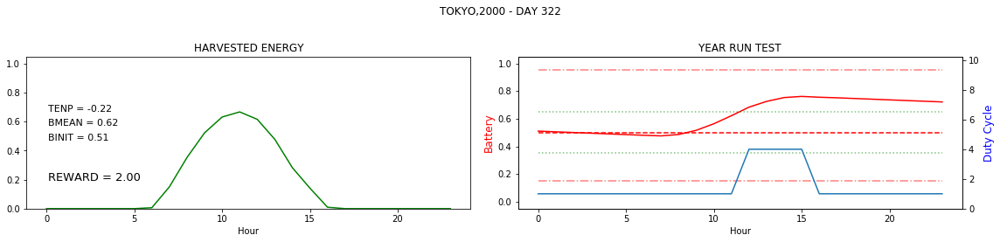

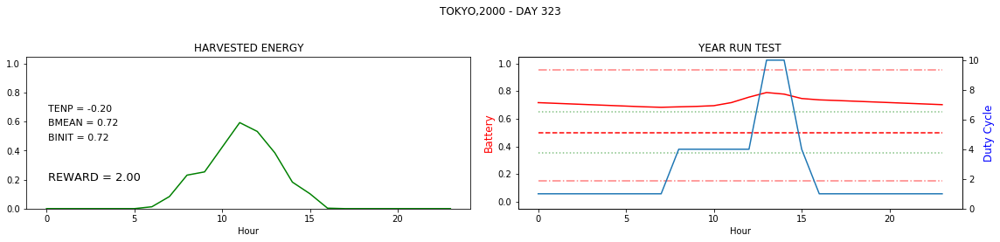

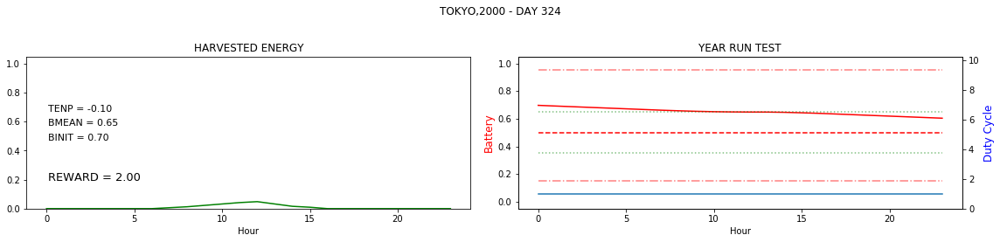

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()